In [2]:
import warnings
warnings.filterwarnings("ignore")
from anndata import AnnData
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import copy

import os
import cv2
import skimage as ski
import matplotlib.pyplot as plt
from PIL import Image
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
Image.MAX_IMAGE_PIXELS = None

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
import stack_data

import time
from st_processing import dis_two_point,get_chip_coord,get_distance_from_point_to_line,get_HE_mask,get_piexl_coods,get_piexl_coods_Mchip,getLinearEquation_new
from st_processing import rgb2gray,adata_flip,adata_Srotate,trans_pN,make_uniq_list
from st_processing import get_adata_STARsolo,get_adata_STARsolo_10x
from st_processing import load_image
#bin 14:10um diameter
#bin 50:25um diameter
#bin 140:100um diameter
color_list=['#1f77b4','#ff7f0e','#2ca02c','#d62728','#9467bd','#8c564b','#e377c2','#7f7f7f','#bcbd22','#17becf',
           '#a6cee3','#fdbf6f','#b2df8a','#fb9a99','#cab2d6','#ffff00','#bd4963','#c5c5fe','#f57682','#6bd76c','#0026bf','#5394c2','#116400','#db654e',
           '#505192','#b56fab','#b0885c','#a8a223','#f4d1b7','#40a4a8','#ea5155','#bc4c94','#a2173b']
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['font.sans-serif'] = 'Arial'

def adata_filter_norm_process(adata_raw,min_cells_num=10,min_genes_num=100,mt_num=20,n_top_genes=12000,use_variable=True,
                              in_tissue=True,image=True,n_clusters=8,scale=False): 
    import time
    start_time = time.time()
    adata=adata_raw.copy()
    if in_tissue:
        adata = adata[adata.obs["in_tissue"] == '1' ]
    if image:
        adata.uns['crop_coord']= [min(adata.obsm['spatial'][:,0])-100, max(adata.obsm['spatial'][:,0])+100,
               min(adata.obsm['spatial'][:,1])-100, max(adata.obsm['spatial'][:,1])+100]

    else:
         adata.uns['crop_coord']= [min(adata.obsm['spatial'][:,0])-3, max(adata.obsm['spatial'][:,0])+3,
               min(adata.obsm['spatial'][:,1])-3, max(adata.obsm['spatial'][:,1])+3]
    if scale:
        sc.pp.filter_cells(adata, min_genes=min_genes_num)
        sc.pp.filter_genes(adata, min_cells=min_cells_num)
        adata = adata[adata.obs["pct_counts_mt"] < mt_num]
        
        adata.layers['raw'] = adata.X.copy()
        sc.pp.normalize_total(adata,target_sum=1e4)
        adata.layers['norm'] = adata.X.copy()
        sc.pp.log1p(adata)
        adata.raw = adata.copy()
        sc.pp.highly_variable_genes(adata,n_top_genes=n_top_genes) 
        adata=adata[:,adata.var.highly_variable]#adata.raw.to_adata()
        sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
        sc.pp.scale(adata, max_value=10)
        
    else:
        sc.pp.filter_cells(adata, min_genes=min_genes_num)
        sc.pp.filter_genes(adata, min_cells=min_cells_num)
        adata = adata[adata.obs["pct_counts_mt"] < mt_num]
        adata.layers['raw'] = adata.X.copy()
        sc.pp.normalize_total(adata,target_sum=1e4)
        adata.raw = adata.copy()
        sc.pp.log1p(adata)
        sc.pp.highly_variable_genes(adata,n_top_genes=n_top_genes) 

    sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=use_variable)
    sc.pp.neighbors(adata,  use_rep='X_pca', n_neighbors=50)
    sc.tl.umap(adata)
    sc.tl.tsne(adata)
    sc.tl.leiden(adata)
    sc.tl.louvain(adata, resolution=1)
    X_pca = adata.obsm['X_pca'] 
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(X_pca) 
    adata.obs['kmeans'] = kmeans.labels_.astype(str)
    
    print('Sample:  '+list(adata.uns['spatial'].keys())[0])
    print(f"#genes after  filter: {adata.n_vars}")
    print(f"#Spot after  filter: {adata.n_obs}")
    print(f"#Median UMIs : {round( np.median(adata.obs['total_counts']),0)}")
    print(f"#Median Genes : {round(np.median(adata.obs['n_genes_by_counts']),0)}")
    print(f"#Mean UMIs : {round( np.mean(adata.obs['total_counts']),0)}")
    print(f"#Mean Genes : {round(np.mean(adata.obs['n_genes_by_counts']),0)}")
    end_time = time.time()
    print("Reading runtime：", round(end_time - start_time,0), "s")
    print('-')
    return adata
def interpolation_M9_150(adata,sample='id',rr=0,cc=0):
    import scipy.sparse as sp
    import random
    import time
    raw_X=adata.X.A.copy()
    adata.obs['Pixel_col']=adata.obsm['spatial'][:,0]
    adata.obs['Pixel_row']=adata.obsm['spatial'][:,1]
    dis=adata.uns['spatial'][sample]['scalefactors']['spot_diameter_fullres']*3
    df_plot=adata[adata.obs["in_tissue"] == '1' ].obs.loc[:,['Spot_col','total_counts']].groupby(['Spot_col']).median()#.plot()
    print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start col adjust')
    for c in df_plot.index[np.min(df_plot.index)+1:np.max([i for i in df_plot.index if i <451])-1]:
        if (c in df_plot.index) & (c-1 in df_plot.index) & (c+1 in df_plot.index):
            if df_plot.loc[c,'total_counts'] < (df_plot.loc[c-1,'total_counts']+df_plot.loc[c+1,'total_counts'])/3:
                for i in adata.obs.index[adata.obs['Spot_col']==c]:
                    col=adata.obs.loc[i,'Pixel_col']
                    row=adata.obs.loc[i,'Pixel_row']
                    tmp_X=raw_X[(adata.obs['sample']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                               (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_col']!=c)]
                    if tmp_X.shape[0] > 1:
                        tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
                        raw_X[adata.obs.index==i]=tmp_X
    print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start row adjust')
    df_plot=adata[adata.obs["in_tissue"] == '1' ].obs.loc[:,['Spot_row','total_counts']].groupby(['Spot_row']).median()#.plot()
    for r in df_plot.index[np.min(df_plot.index)+1:np.max([i for i in df_plot.index if i <451])-1]:
        if (r in df_plot.index) & (r-1 in df_plot.index) & (r+1 in df_plot.index):
            if df_plot.loc[r,'total_counts'] < (df_plot.loc[r-1,'total_counts']+df_plot.loc[r+1,'total_counts'])/3:
                for i in adata.obs.index[adata.obs['Spot_row']==r]:
                    col=adata.obs.loc[i,'Pixel_col']
                    row=adata.obs.loc[i,'Pixel_row']
                    tmp_X=raw_X[(adata.obs['sample']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                               (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_row']!=r)]
                    if tmp_X.shape[0] > 1:
                        tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
                        raw_X[adata.obs.index==i]=tmp_X
    if (cc>0) & (rr>0):
        for i in adata.obs.index[(adata.obs['Spot_col']==cc) & (adata.obs['Spot_row']<rr) ]:
            col=adata.obs.loc[i,'Pixel_col']
            row=adata.obs.loc[i,'Pixel_row']
            tmp_X=raw_X[(adata.obs['sample']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                       (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_col']!=cc)]
            if tmp_X.shape[0] > 1:
                tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
                raw_X[adata.obs.index==i]=tmp_X
    print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start col interpolation')
    dis=adata.uns['spatial'][sample]['scalefactors']['spot_diameter_fullres']*7.5
    l=list(adata.obs['Spot_col'])
    adata.obs['sample_2']=adata.obs['sample']
    for c in [451,457,452,456,453,455,454,458,464,459,463,460,462,461]:
        adata.obs['sample_2'][adata.obs['Spot_col']==c]=='add2'
        if (c in l):
            for i in adata.obs.index[adata.obs['Spot_col']==c]:
                col=adata.obs.loc[i,'Pixel_col']
                row=adata.obs.loc[i,'Pixel_row']
                if adata.obs.loc[i,'Spot_row']>450:
                    tmp_X=raw_X[(adata.obs['sample_2']!='add')&(adata.obs['Pixel_col']<(col+dis*2)) & (adata.obs['Pixel_col']>(col-dis*2)) & 
                               (adata.obs['Pixel_row']<(row+dis*2)) & (adata.obs['Pixel_row']>(row-dis*2)) & (adata.obs['Spot_col']!=c)]
                else:
                    tmp_X=raw_X[(adata.obs['sample_2']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                               (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_col']!=c)]
                if tmp_X.shape[0] > 1:
                    tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
                    raw_X[adata.obs.index==i]=tmp_X
    print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start row interpolation')
    l=list(adata.obs['Spot_row'])
    for r in [451,457,452,456,453,455,454,458,464,459,463,460,462,461]:
        adata.obs['sample_2'][adata.obs['Spot_row']==r]=='add2'
        if (r in l):
            for i in adata.obs.index[adata.obs['Spot_row']==r]:
                col=adata.obs.loc[i,'Pixel_col']
                row=adata.obs.loc[i,'Pixel_row']
                if adata.obs.loc[i,'Spot_col']>450:
                    tmp_X=raw_X[(adata.obs['sample_2']!='add')&(adata.obs['Pixel_col']<(col+dis*2)) & (adata.obs['Pixel_col']>(col-dis*2)) & 
                               (adata.obs['Pixel_row']<(row+dis*2)) & (adata.obs['Pixel_row']>(row-dis*2)) & (adata.obs['Spot_row']!=r)]
                else:
                    tmp_X=raw_X[(adata.obs['sample_2']!='add')&(adata.obs['Pixel_col']<(col+dis)) & (adata.obs['Pixel_col']>(col-dis)) & 
                               (adata.obs['Pixel_row']<(row+dis)) & (adata.obs['Pixel_row']>(row-dis)) & (adata.obs['Spot_row']!=r)]
                if tmp_X.shape[0] > 1:
                    tmp_X=tmp_X[random.randint(0, tmp_X.shape[0]-1),:]
                    raw_X[adata.obs.index==i]=tmp_X
                    
    adata.X=sp.csr_matrix(raw_X)
    sc.pp.calculate_qc_metrics(adata, qc_vars=["mt","rp","hb"], inplace=True)
    return adata

In [223]:
adata_E17 = sc.read('adata_E17_annotation.h5ad')
adata_P0= sc.read('adata_P0_annotation.h5ad')
adata_P4= sc.read('adata_P4_annotation.h5ad')

## 3.1聚类

### E17.5

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


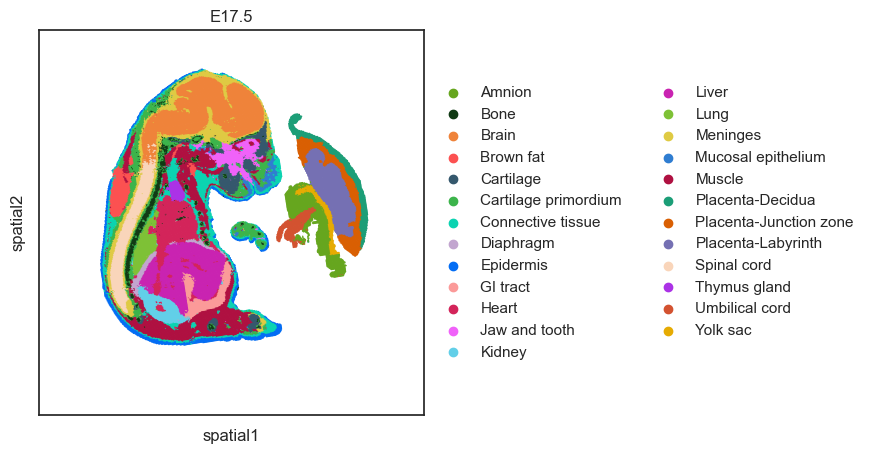

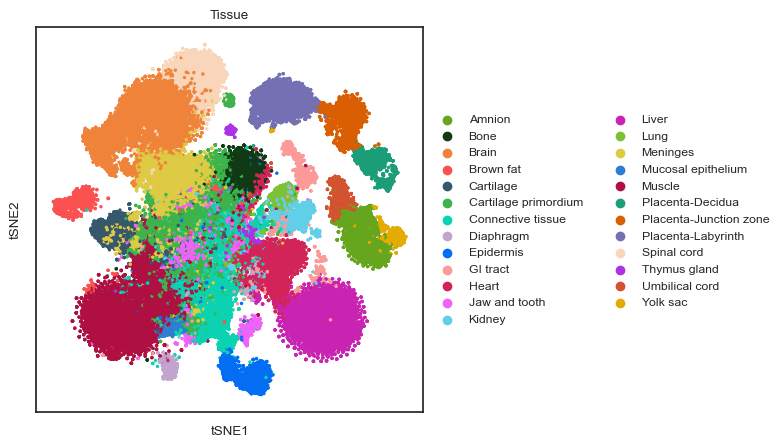

In [189]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
s=18
sc.pl.spatial(adata_E17, img_key=None,spot_size=s, 
              color='Tissue', cmap='Spectral_r',palette=color_dict,
              #legend_loc=None,
              title='E17.5',crop_coord=[ 0, 5000, 0, 5000],
              show=False)

import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=0.8)
sc.pl.tsne(adata_E17, size=25,#legend_loc='on data',
              palette=color_dict,
              color=['Tissue'], cmap='Spectral_r', 
             show=False)


### P0

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


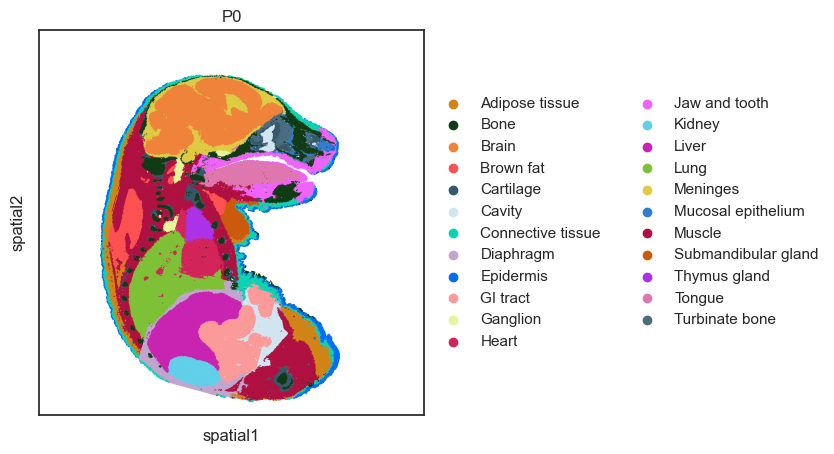

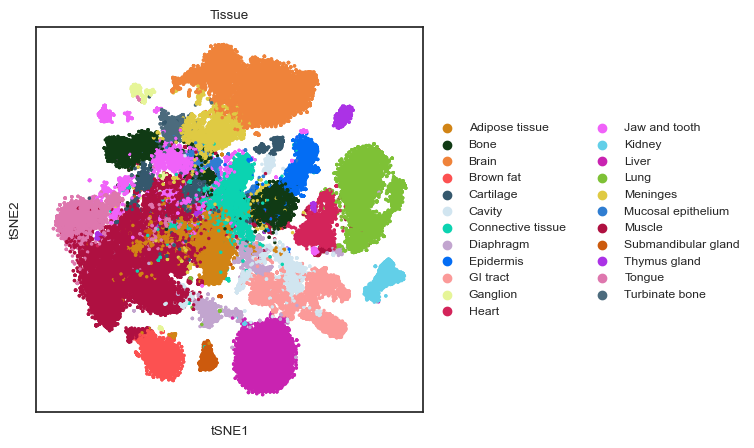

In [190]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
s=18
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color='Tissue', cmap='Spectral_r',palette=color_dict,
              #legend_loc=None,
              title='P0',crop_coord=[ 0, 5000, 0, 5000],
              show=False)

import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=0.8)
sc.pl.tsne(adata_P0, size=25,#legend_loc='on data',
              palette=color_dict,
              color=['Tissue'], cmap='Spectral_r', 
             show=False)


### P4

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


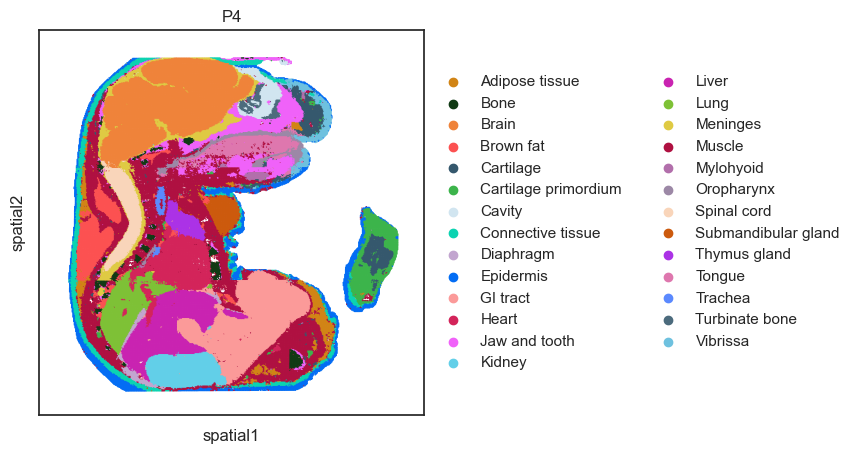

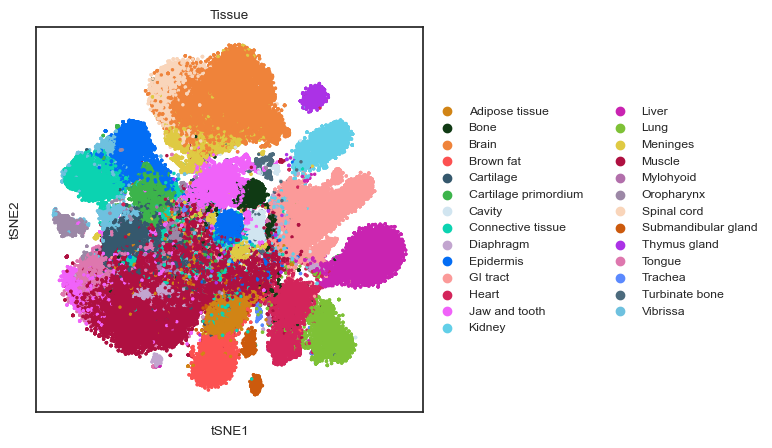

In [191]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
s=18
sc.pl.spatial(adata_P4, img_key=None,spot_size=s, 
              color='Tissue', cmap='Spectral_r',palette=color_dict,
              #legend_loc=None,
              title='P4',crop_coord=[ 0, 5000, 0, 5000],
              show=False)

import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=0.8)
sc.pl.tsne(adata_P4, size=25,#legend_loc='on data',
              palette=color_dict,
              color=['Tissue'], cmap='Spectral_r', 
             show=False)



## Marker

In [192]:
adata_E17.uns['log1p']['base']=None
adata_P0.uns['log1p']['base']=None
adata_P4.uns['log1p']['base']=None
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start rank_genes_groups1')
sc.tl.rank_genes_groups(adata_E17, groupby='Tissue', method='wilcoxon', use_raw =False)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start rank_genes_groups2')
sc.tl.rank_genes_groups(adata_P0, groupby='Tissue', method='wilcoxon', use_raw =False)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start rank_genes_groups3')
sc.tl.rank_genes_groups(adata_P4, groupby='Tissue', method='wilcoxon', use_raw =False)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start filter_rank_genes_groups')
sc.tl.filter_rank_genes_groups(adata_E17)
sc.tl.filter_rank_genes_groups(adata_P0)
sc.tl.filter_rank_genes_groups(adata_P4)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - End')

In [198]:
# 每个聚类的前10个高差异表达的基因
rank_genes = pd.DataFrame(adata_P4.uns['rank_genes_groups_filtered']['names'])
print(rank_genes.head(3))
[i for i in rank_genes['Adipose tissue'][0:10] if isinstance(i, (str, bytes))]

  Adipose tissue Bone  Brain Brown fat Cartilage Cartilage primordium  \
0            NaN  NaN    NaN       NaN       NaN                  NaN   
1           Car3  NaN    NaN     Cidea       NaN                  NaN   
2            Cfd  NaN  Stmn2       NaN      Dlk1                  NaN   

    Cavity Connective tissue Diaphragm Epidermis  ... Muscle Mylohyoid  \
0  Bpifb9b             Krt71       NaN     Krt10  ...    NaN       NaN   
1   Wfdc18             Krt25       NaN      Krt1  ...    NaN       NaN   
2  Bpifb9a              Tchh       NaN      Krt5  ...    NaN       NaN   

  Oropharynx Spinal cord Submandibular gland Thymus gland Tongue  Trachea  \
0      Krt13       Vsnl1               Mucl2        Trbc2    Sln  Scgb3a1   
1       Krt4       Stmn2              Bpifa2        Trbc1    NaN  Scgb3a2   
2      Krt15     Sparcl1               Muc19          NaN    NaN    Reg3g   

  Turbinate bone Vibrissa  
0         Wfdc18      NaN  
1        Bpifb9b   S100a6  
2          Lcn11 

['Car3', 'Cfd', 'Lpl', 'Adipoq', 'Retn', 'Cd36', 'Plin4']

In [211]:
rank_genes.columns

Index(['Adipose tissue', 'Bone', 'Brain', 'Brown fat', 'Cartilage',
       'Cartilage primordium', 'Cavity', 'Connective tissue', 'Diaphragm',
       'Epidermis', 'GI tract', 'Heart', 'Jaw and tooth', 'Kidney', 'Liver',
       'Lung', 'Meninges', 'Muscle', 'Mylohyoid', 'Oropharynx', 'Spinal cord',
       'Submandibular gland', 'Thymus gland', 'Tongue', 'Trachea',
       'Turbinate bone', 'Vibrissa'],
      dtype='object')

In [218]:
marker_genes_dict={}
for c in rank_genes.columns:
    marker_genes_dict[c]=[i for i in rank_genes[c] if isinstance(i, (str, bytes))][0:3]


In [227]:
marker_genes_dict_E17=marker_genes_dict
for c in rank_genes.columns:
    marker_genes_dict_E17[c]=  [i for i in marker_genes_dict_E17[c] if i in adata_E17.var_names]
    
marker_genes_dict_P0=marker_genes_dict
for c in rank_genes.columns:
    marker_genes_dict_P0[c]=  [i for i in marker_genes_dict_P0[c] if i in adata_E17.var_names]

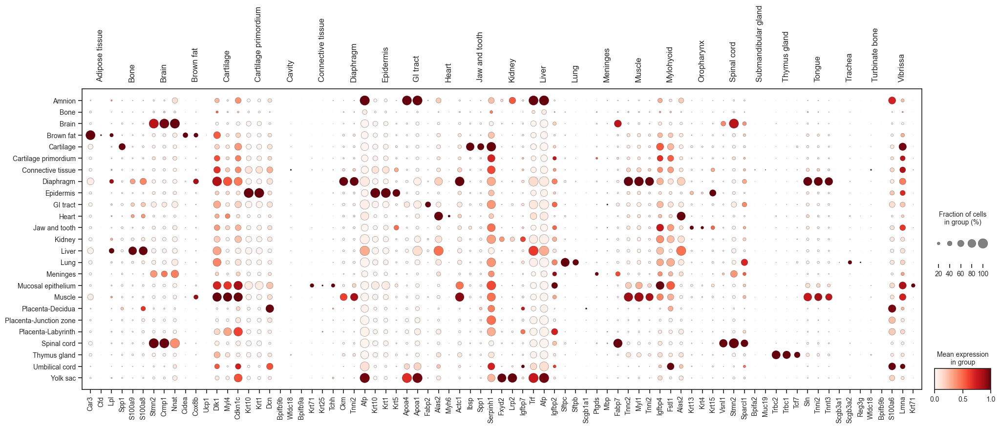

In [226]:
sc.pl.dotplot(adata_E17, marker_genes_dict_E17, 
              groupby="Tissue",figsize=(24,8),show=True,
              standard_scale='var',dendrogram=False)

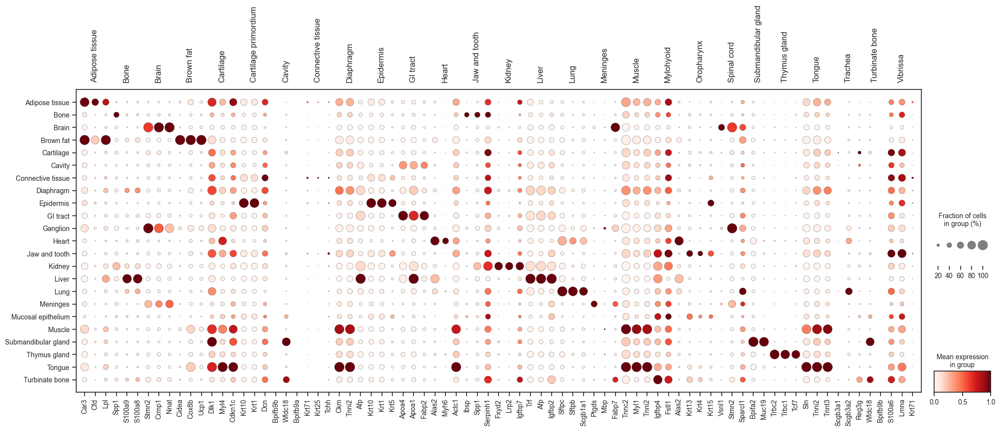

In [228]:
sc.pl.dotplot(adata_P0, marker_genes_dict_P0, 
              groupby="Tissue",figsize=(24,8),show=True,
              standard_scale='var',dendrogram=False)

meta NOT subset; don't know how to subset; dropped


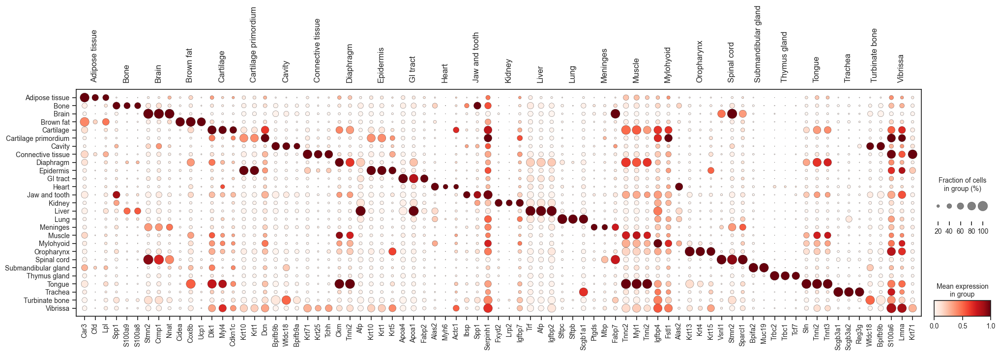

In [237]:
sc.pl.dotplot(adata_P4, marker_genes_dict, 
              groupby="Tissue",figsize=(24,6),show=False,
              standard_scale='var',dendrogram=False)
plt.savefig('../Figure/Figure3/Figure-marker-dotplot-P4.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

meta NOT subset; don't know how to subset; dropped


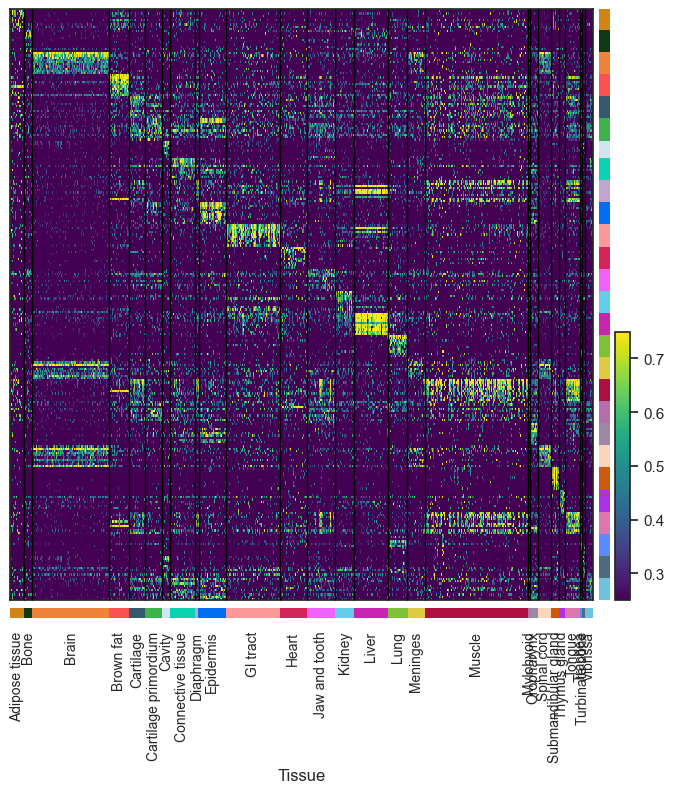

In [248]:
sc.pl.rank_genes_groups_heatmap(adata_P4,n_genes=10,key='rank_genes_groups_filtered',
                                swap_axes=True,cmap='viridis', dendrogram=False,
                                figsize=(8,8),standard_scale='var',show=False,
                                vmin=0.25,vmax=0.75,
                               use_raw=False)
plt.savefig('../Figure/Figure3/Figure-marker-heatmap-P4.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

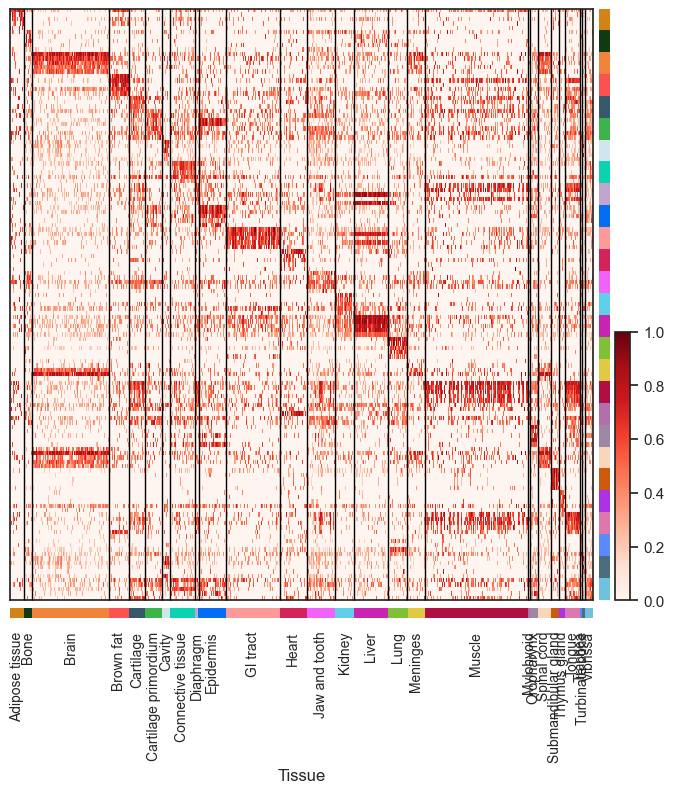

In [247]:
sns.set(style="ticks", font_scale=1)
sc.pl.rank_genes_groups_heatmap(adata_P4,n_genes=5,
                                key='rank_genes_groups_filtered',
                                swap_axes=True,
                                cmap='Reds', dendrogram=False,
                                figsize=(8,8),standard_scale='var',
                                #vmin=0.31,vmax=0.8,
                               use_raw=False,
                               show=True)
#plt.savefig('D:/Task/Zhao_lab/Zhujunjie/file/Fig/Fig4/Fig4-heatmap-brian.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

[<AxesSubplot: title={'center': 'Nnat'}, xlabel='spatial1', ylabel='spatial2'>]

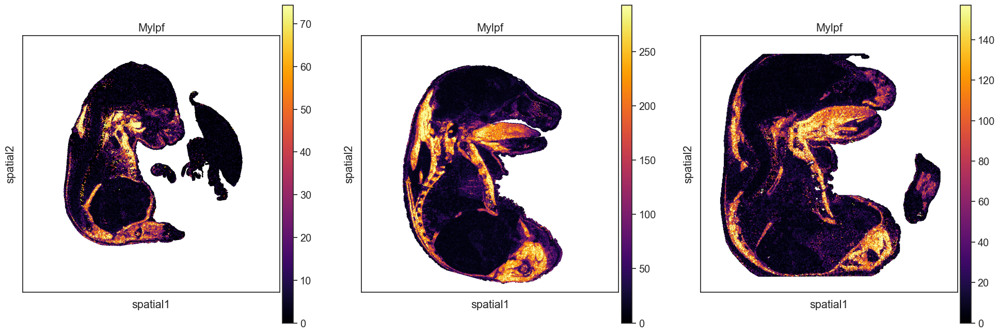

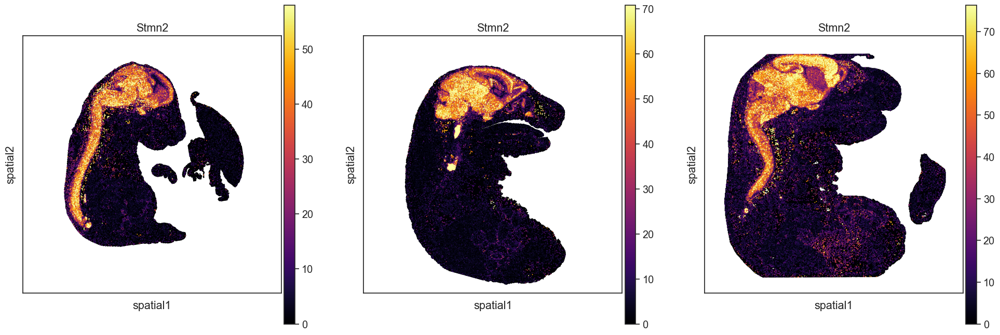

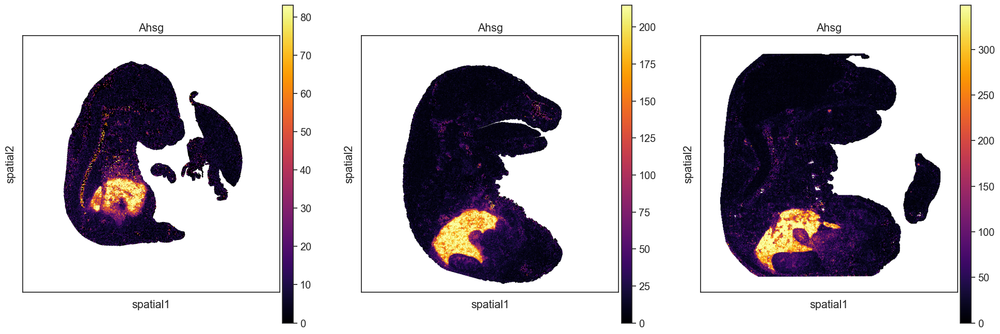

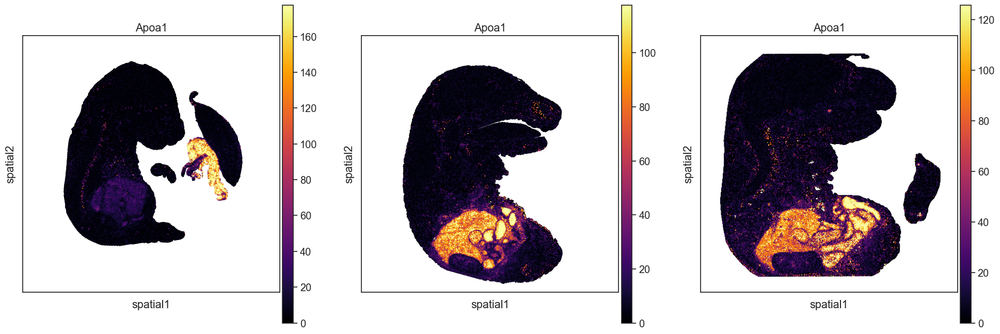

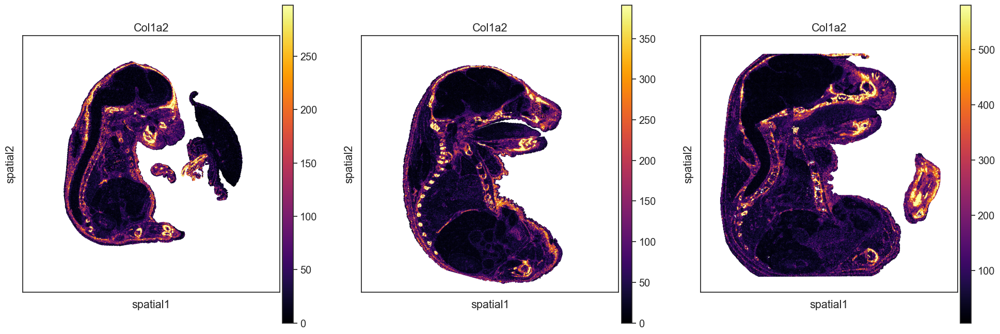

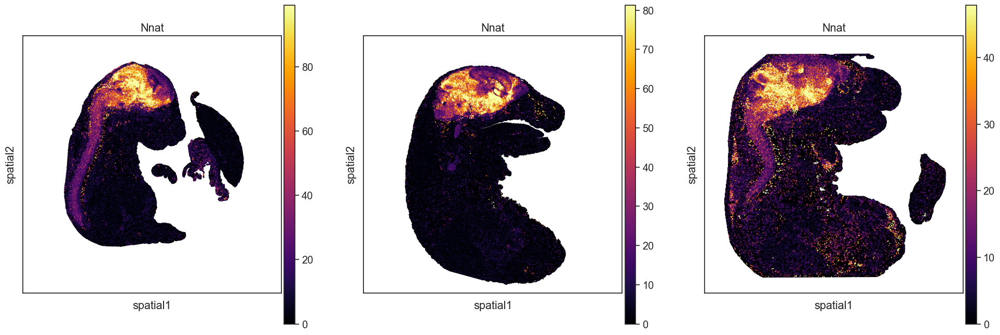

In [249]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Mylpf'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Stmn2'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Ahsg'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Apoa1'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Col1a2'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Nnat'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Apoa1'}, xlabel='spatial1', ylabel='spatial2'>]

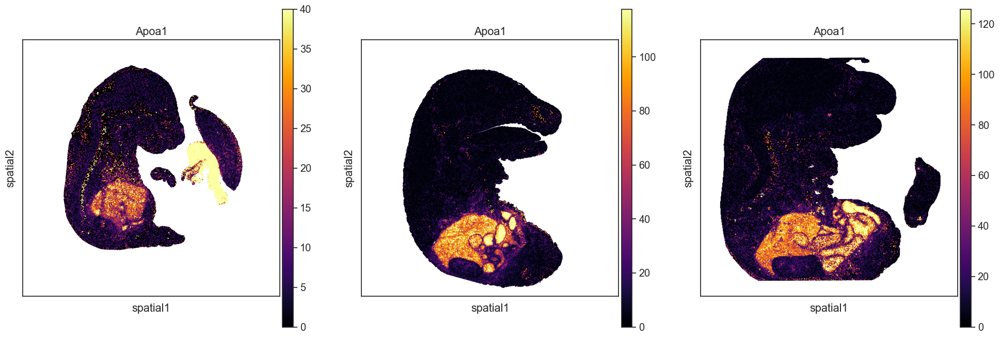

In [271]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Apoa1'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax=40,
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Sftpc'}, xlabel='spatial1', ylabel='spatial2'>]

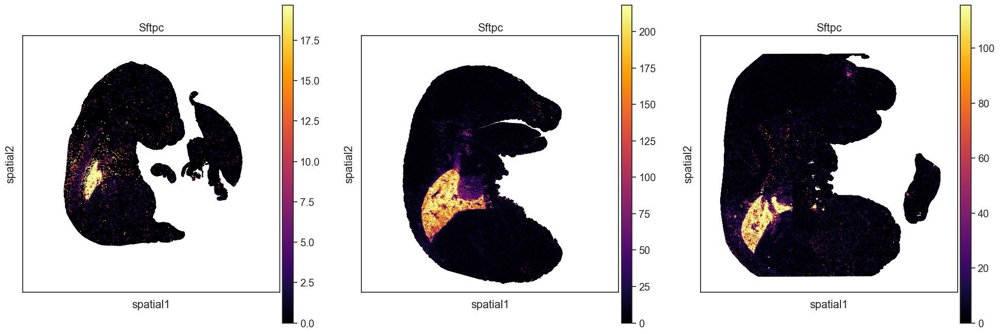

In [270]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Sftpc'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Trbc2'}, xlabel='spatial1', ylabel='spatial2'>]

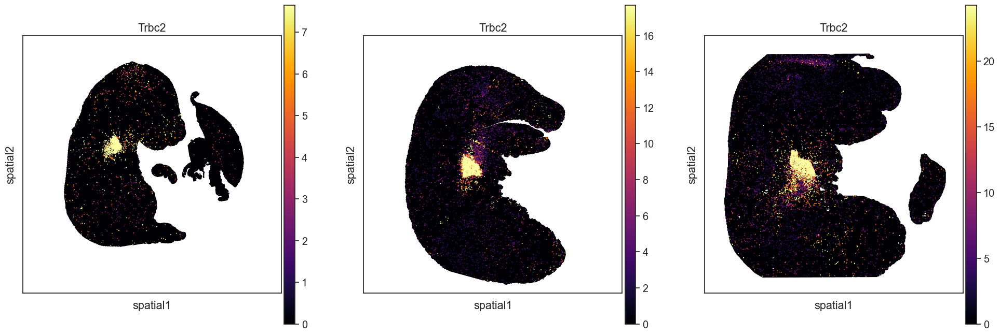

In [269]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Trbc2'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Trbc1'}, xlabel='spatial1', ylabel='spatial2'>]

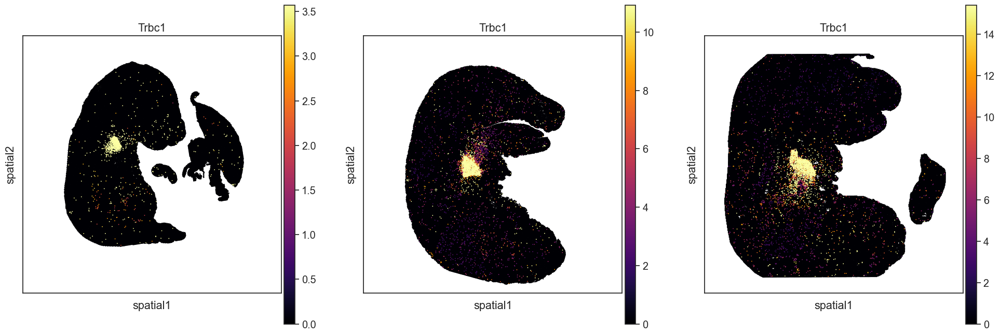

In [268]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Trbc1'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Tcf7'}, xlabel='spatial1', ylabel='spatial2'>]

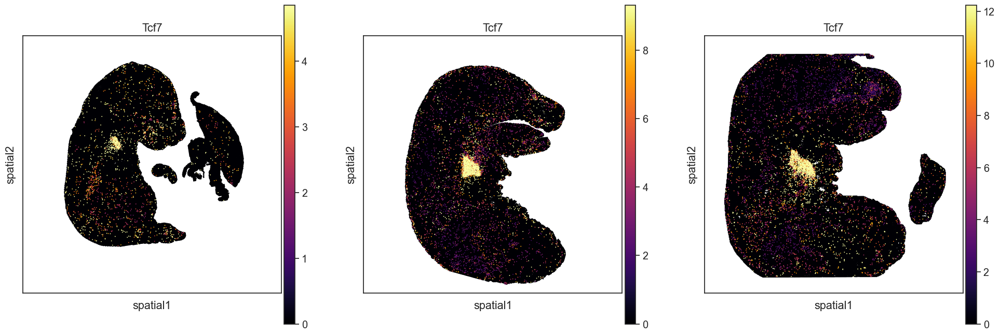

In [255]:

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Tcf7'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'S100a9'}, xlabel='spatial1', ylabel='spatial2'>]

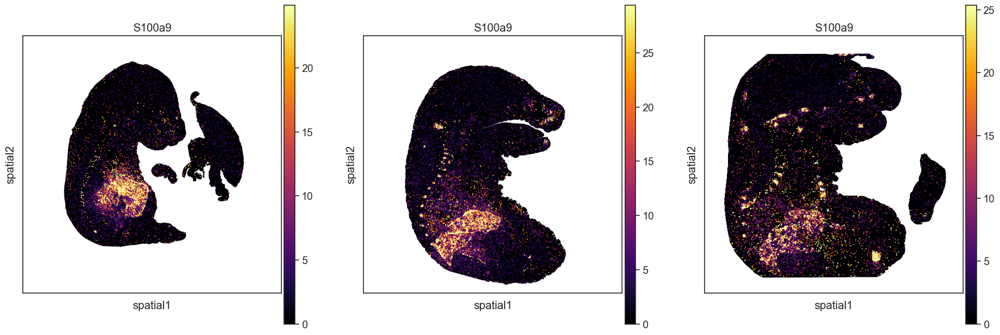

In [260]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='S100a9'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Alas2'}, xlabel='spatial1', ylabel='spatial2'>]

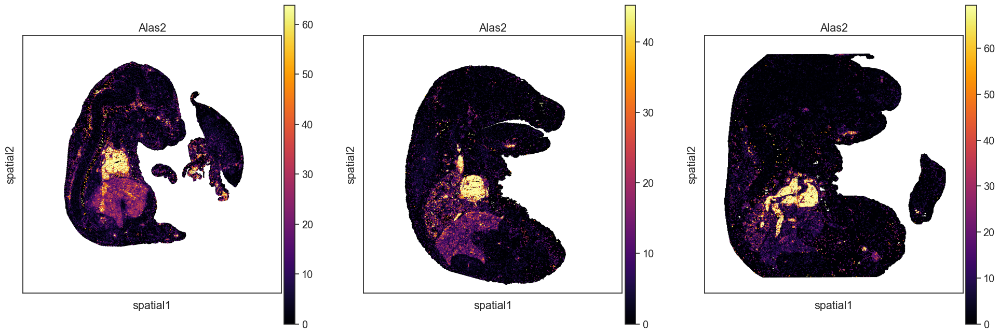

In [261]:

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Alas2'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Myh6'}, xlabel='spatial1', ylabel='spatial2'>]

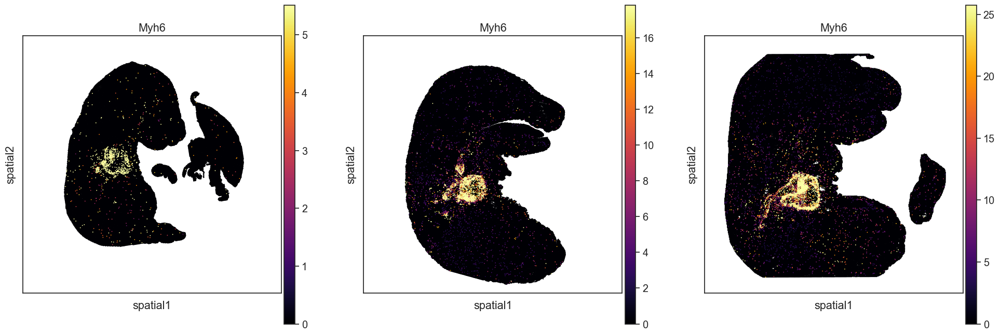

In [266]:

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Myh6'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)

[<AxesSubplot: title={'center': 'Krt10'}, xlabel='spatial1', ylabel='spatial2'>]

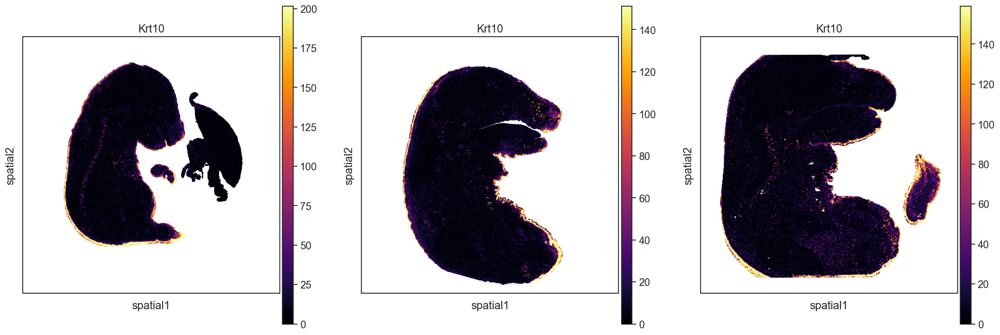

In [265]:

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Krt10'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


[<AxesSubplot: title={'center': 'Fabp2'}, xlabel='spatial1', ylabel='spatial2'>]

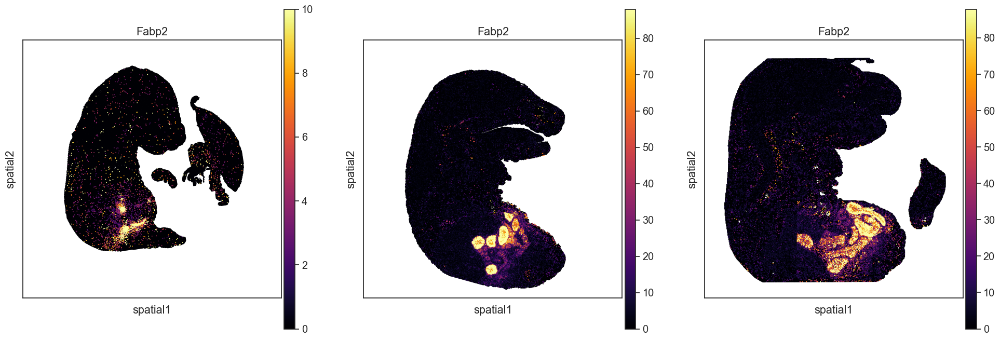

In [275]:

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Fabp2'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax=10,
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


[<AxesSubplot: title={'center': 'Lrp2'}, xlabel='spatial1', ylabel='spatial2'>]

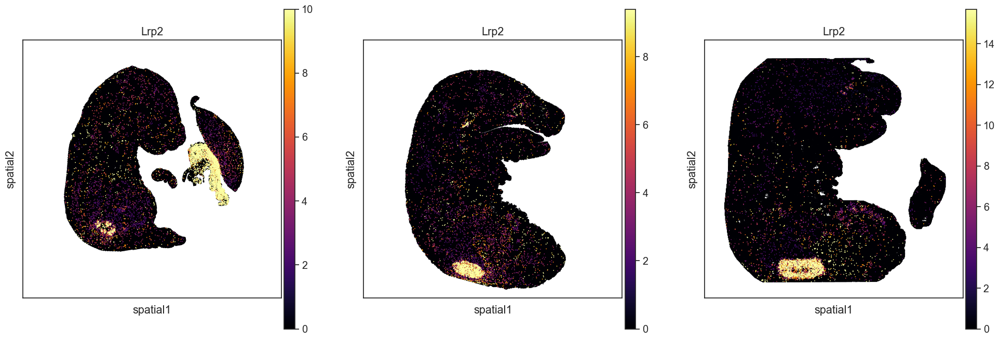

In [273]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Lrp2'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax=10,
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


[<AxesSubplot: title={'center': 'Trf'}, xlabel='spatial1', ylabel='spatial2'>]

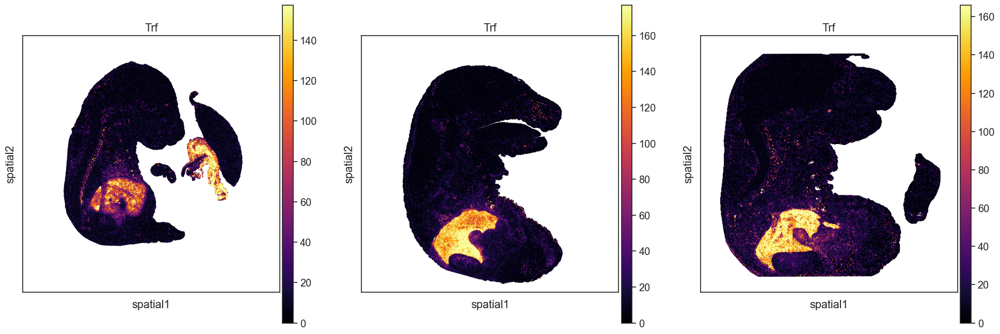

In [276]:

sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Trf'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


[<AxesSubplot: title={'center': 'Afp'}, xlabel='spatial1', ylabel='spatial2'>]

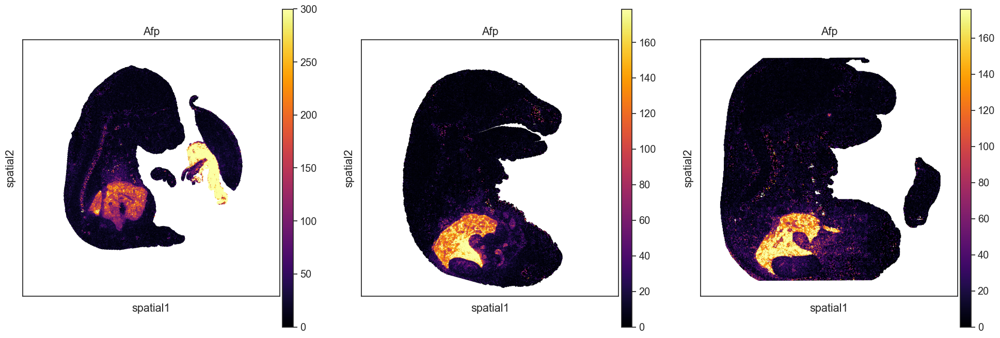

In [278]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
s=18
c='Afp'
sc.pl.spatial(adata_E17,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax=300,
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0], show=False)
sc.pl.spatial(adata_P0, img_key=None,spot_size=s, 
              color=[c], cmap='inferno', vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[1], show=False)
sc.pl.spatial(adata_P4,img_key=None,spot_size=s, 
              color=[c], cmap='inferno',  vmin='p5',vmax='p99',
              basis='spatial' ,crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[2], show=False)


# Brain

In [63]:
adata_E17_Brain =sc.read('adata_E17_Brain_annotation.h5ad')
adata_P0_Brain=sc.read('adata_P0_Brain_annotation.h5ad')
adata_P4_Brain =sc.read('adata_P4_Brain_annotation.h5ad')

## 可视化

In [174]:
color_dict={'Chp': '#90cbed',
     'DPall VZ':'#e08537',
     'DPall_1':'#cfc43e',
     'DPall_2': '#e59393',  
     'Die': '#8594b1',    
     'FMN':'#861e58',
     'Hb':'#d486af',
     'Hy': '#865337',
     'MPall': '#17becf',
     'Mb': '#88b370',
     'Mb IC': '#a64a90',
     'Mb VZ': '#ad72ad',
     'SPall Rd': '#8b5b99',
     'SPall Rv':'#cab2d6',
     'SPall VZ':'#b3df8b', 
     'Spc': '#f2d4bc',
     'CbN': '#1f77b4',
     'Cere_EGZ': '#3ba63b',
     'Cere_PCC': '#ff7f0e',
     'DPall_3': '#e28534',
     'Medulla and Pons(Hb)':'#d486af',
     'OB_1': '#fb9a99',
     'OB_2': '#cab2d6',
     'OB_3': '#ffff24',
     'OLF': '#ac461f',
     'CbXWM': '#ff7f0e',
     'CbXegr': '#3ba63b',
     'CbXigr': '#d62728',
     'CbXpu': '#0026bf',
     'Fiber tracts': '#cccccc',
     'ORB': '#f57682',
            'PG':'#abd9e9',
     'PAL(SPall)': '#96a7d3',
    'STRd(SPall)': '#8b5b99',
    'STRv(SPall)': '#cab2d6',
     'Substantia nigra': '#66a73f',
     'Thal(Die)': '#8594b1'
           }

meta NOT subset; don't know how to subset; dropped


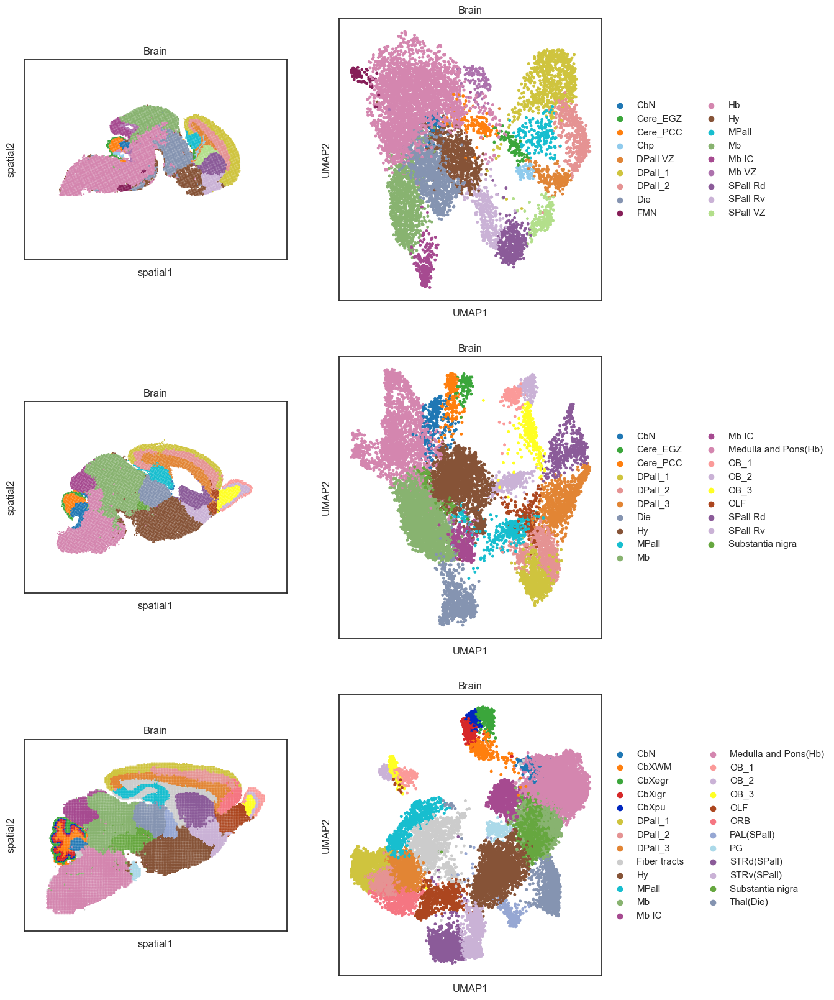

In [175]:

sns.set(style="ticks", font_scale=1)
fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(12,20))
s=12

c='Brain'
sc.pl.spatial(adata_E17_Brain,img_key=None,spot_size=s, palette=color_dict,legend_loc=None,
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 1230-200,3230+200,407-200,1757+200],
              ax=axes[0,0], show=False)
sc.pl.spatial(adata_P0_Brain, img_key=None,spot_size=s, palette=color_dict,legend_loc=None,
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[ 1284-200,3284+200,438-200,1785+200],
              ax=axes[1,0], show=False)

sc.pl.spatial(adata_P4_Brain,img_key=None,spot_size=s, palette=color_dict,legend_loc=None,
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,crop_coord=[790-200,2790+200,350-200,1700+200],
              ax=axes[2,0], show=False)

sc.pl.umap(adata_E17_Brain, size=50,palette=color_dict,

              color=[c], cmap='Spectral_r', 
              ax=axes[0,1], show=False)
sc.pl.umap(adata_P0_Brain, size=50,palette=color_dict,

              color=[c], cmap='Spectral_r', 
              ax=axes[1,1], show=False)
sc.pl.umap(adata_P4_Brain, size=50,palette=color_dict,
              color=[c], cmap='Spectral_r', 
              ax=axes[2,1], show=False)
plt.savefig('../Figure/Figure3/Figure3-Brain.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [ ]:
color_dict={'Adipose tissue':'#d18415',
    'Brown fat': '#fc5151',
     'Bone':'#103a14',
     'Brain':'#ef833a',
     'Cartilage': '#35586d',
     'Cartilage primordium': '#3cb44b',
    'Cavity':'#d1e5f0',
     'Connective tissue': '#0bd3b1',
     'Diaphragm': '#c2a5cf',
     'Dorsal root ganglion': '#d8e0eb',
     'Epidermis': '#036df4',
     'GI tract': '#fb9a99',
     'Ganglion':'#e6f598',
     'Heart': '#d3245a',
     'Jaw and tooth': '#f062f9',
     'Kidney': '#62cfe8',
     'Liver': '#c923b1',
     'Lung': '#7ec136',
     'Meninges': '#dfca43',
     'Mucosal epithelium': '#2f7dd1',
     'Muscle': '#af1041',
    'Mylohyoid':'#b26fab',
     'Olfactory epithelium':'#bd3add',
    'Oropharynx':'#9c88a6',
     'Pituitary gland':'#ff8e6d',
    'Amnion': '#66a61e',
    'Placenta-Decidua': '#1b9e77',
    'Placenta-Junction zone': '#d95f02',
    'Placenta-Labyrinth':'#7570b3',
    'Umbilical cord': '#d35230',
    'Yolk sac': '#e6ab02',
     'Spinal cord': '#f9d5ba',
     'Submandibular gland': '#cc5a0d',
     'Trachea':'#5b89fe',
     'Thymus gland': '#ab32e6',
     'Tongue':'#de77ae',
           'Turbinate bone':'#4c6b7d',
           'Vibrissa':'#6ec1df'}


adata_E17_GI=adata_E17[(adata_E17.obs['Tissue']=='GI tract')]
adata_P0_GI=adata_P0[(adata_P0.obs['Tissue']=='GI tract')]
adata_P4_GI=adata_P4[(adata_P4.obs['Tissue']=='GI tract')]

# adata_E17_GI=adata_E17_GI[(adata_E17_GI.obsm['spatial'][:,1]<1500)& (adata_E17_Brain.obsm['spatial'][:,0]<2950) ]
# adata_P0_Brain=adata_P0_Brain[(adata_P0_Brain.obsm['spatial'][:,1]<1800) & (adata_P0_Brain.obsm['spatial'][:,0]<3200)]
# adata_P4_Brain=adata_P4_Brain[(adata_P4_Brain.obsm['spatial'][:,1]<1700) & (adata_P4_Brain.obsm['spatial'][:,0]<3200)]

In [ ]:
adata_P4_GI=adata_P4[(adata_P4.obs['Tissue']=='GI tract')]
adata_P4_GI=adata_P4_GI[(adata_P4_GI.obsm['spatial'][:,1]>3100) & (adata_P4_GI.obsm['spatial'][:,0]>1550)]

[<AxesSubplot: title={'center': 'Tissue'}, xlabel='spatial1', ylabel='spatial2'>]

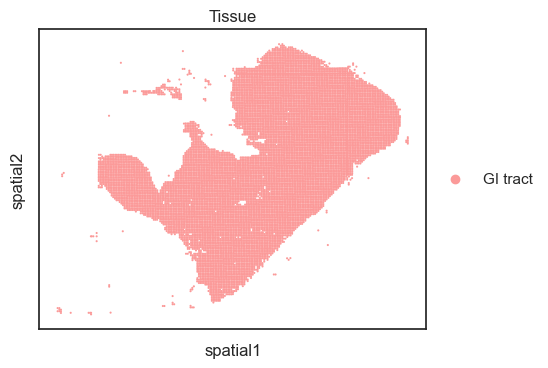

In [ ]:
sc.pl.spatial(adata_P4_GI,img_key=None,spot_size=s, 
              color=['Tissue'], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,#crop_coord=[ 0, 5000, 0, 5000],
              show=False)

In [815]:

import scanpy.external as sce
import time
adata_E17_GI.uns['log1p']['base']=None
sc.pp.highly_variable_genes(adata_E17_GI,n_top_genes=16000) 
sc.tl.pca(adata_E17_GI, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata_E17_GI,  use_rep='X_pca', n_neighbors=50)
sq.gr.spatial_neighbors(adata_E17_GI, coord_type="grid",spatial_key='spatial')
adata_E17_GI.uns['connectivities']=adata_E17_GI.obsp['connectivities']
adata_E17_GI.obsp['connectivities']  = adata_E17_GI.obsp['connectivities'] + adata_E17_GI.obsp['spatial_connectivities'] 
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start umap')
sc.tl.umap(adata_E17_GI)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start leiden')
sc.tl.leiden(adata_E17_GI, resolution=1,key_added='leiden_all')
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - End')

2024-05-14 21:57:48  - Start umap
2024-05-14 21:57:55  - Start leiden
2024-05-14 21:57:57  - End


In [816]:
import time
adata_P0_GI.uns['log1p']['base']=None
sc.pp.highly_variable_genes(adata_P0_GI,n_top_genes=16000) 
sc.tl.pca(adata_P0_GI, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata_P0_GI,  use_rep='X_pca', n_neighbors=50)
sq.gr.spatial_neighbors(adata_P0_GI, coord_type="grid",spatial_key='spatial')
adata_P0_GI.uns['connectivities']=adata_P0_GI.obsp['connectivities']
adata_P0_GI.obsp['connectivities']  = adata_P0_GI.obsp['connectivities'] + adata_P0_GI.obsp['spatial_connectivities'] 
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start umap')
sc.tl.umap(adata_P0_GI)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start leiden')
sc.tl.leiden(adata_P0_GI, resolution=1,key_added='leiden_all')
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - End')

2024-05-14 21:58:17  - Start umap
2024-05-14 21:58:37  - Start leiden
2024-05-14 21:58:45  - End


In [842]:

import time
adata_P4_GI.uns['log1p']['base']=None
sc.pp.highly_variable_genes(adata_P4_GI,n_top_genes=16000) 
sc.tl.pca(adata_P4_GI, svd_solver="arpack", use_highly_variable=True)
sc.pp.neighbors(adata_P4_GI,  use_rep='X_pca', n_neighbors=50)
sq.gr.spatial_neighbors(adata_P4_GI, coord_type="grid",spatial_key='spatial')
adata_P4_GI.uns['connectivities']=adata_P4_GI.obsp['connectivities']
adata_P4_GI.obsp['connectivities']  = adata_P4_GI.obsp['connectivities'] + adata_P4_GI.obsp['spatial_connectivities'] 
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start umap')
sc.tl.umap(adata_P4_GI)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start leiden')
sc.tl.leiden(adata_P4_GI, resolution=1,key_added='leiden_all')
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - End')

2024-05-14 22:05:49  - Start umap
2024-05-14 22:06:07  - Start leiden
2024-05-14 22:06:48  - End


<AxesSubplot: title={'center': 'leiden_all'}, xlabel='UMAP1', ylabel='UMAP2'>

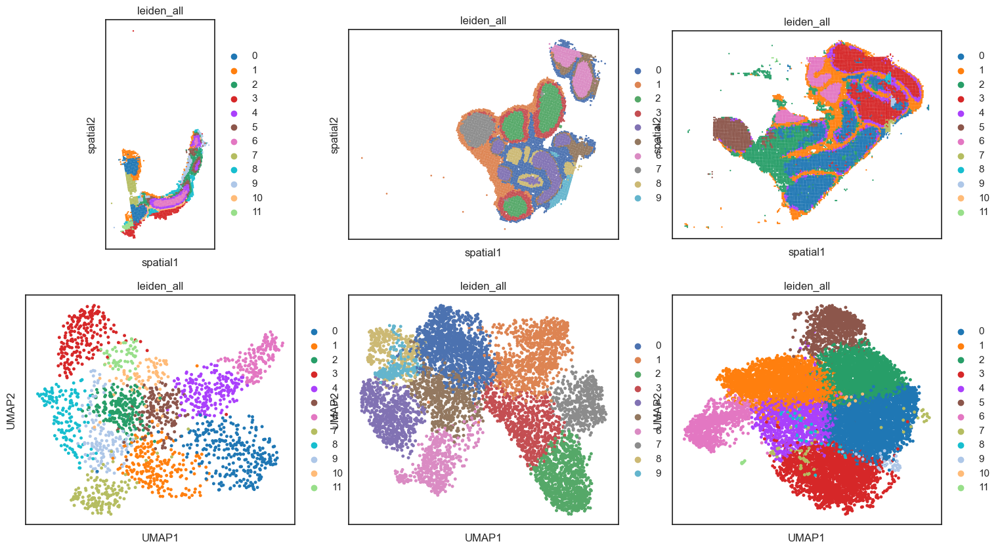

In [843]:

sns.set(style="ticks", font_scale=1)
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18,10))
s=12

c='leiden_all'
sc.pl.spatial(adata_E17_GI,img_key=None,spot_size=s, 
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,#crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0,0], show=False)
sc.pl.spatial(adata_P0_GI, img_key=None,spot_size=s, 
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,#crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0,1], show=False)

sc.pl.spatial(adata_P4_GI,img_key=None,spot_size=s, 
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,#crop_coord=[ 0, 5000, 0, 5000],
              ax=axes[0,2], show=False)

sc.pl.umap(adata_E17_GI, size=50,

              color=[c], cmap='Spectral_r', 
              ax=axes[1,0], show=False)
sc.pl.umap(adata_P0_GI, size=50,

              color=[c], cmap='Spectral_r', 
              ax=axes[1,1], show=False)
sc.pl.umap(adata_P4_GI, size=50,
              color=[c], cmap='Spectral_r', 
              ax=axes[1,2], show=False)

# 小脑发育分析

In [298]:
color_dict={'Chp': '#90cbed',
     'DPall VZ':'#e08537',
     'DPall_1':'#cfc43e',
     'DPall_2': '#e59393',  
     'Die': '#8594b1',    
     'FMN':'#861e58',
     'Hb':'#d486af',
     'Hy': '#865337',
     'MPall': '#17becf',
     'Mb': '#88b370',
     'Mb IC': '#a64a90',
     'Mb VZ': '#ad72ad',
     'SPall Rd': '#8b5b99',
     'SPall Rv':'#cab2d6',
     'SPall VZ':'#b3df8b', 
     'Spc': '#f2d4bc',
     'CbN': '#1f77b4',
     'Cere_EGZ': '#3ba63b',
     'Cere_PCC': '#ff7f0e',
     'DPall_3': '#e28534',
     'Medulla and Pons(Hb)':'#d486af',
     'OB_1': '#fb9a99',
     'OB_2': '#cab2d6',
     'OB_3': '#ffff24',
     'OLF': '#ac461f',
     'CbXWM': '#ff7f0e',
     'CbXegr': '#3ba63b',
     'CbXigr': '#d62728',
     'CbXpu': '#0026bf',
     'Fiber tracts': '#cccccc',
     'ORB': '#f57682',
            'PG':'#abd9e9',
     'PAL(SPall)': '#96a7d3',
    'STRd(SPall)': '#8b5b99',
    'STRv(SPall)': '#cab2d6',
     'Substantia nigra': '#66a73f',
     'Thal(Die)': '#8594b1'
           }

In [2]:
adata_E17_Brain=sc.read('adata_E17_Brain_annotation.h5ad')
adata_P0_Brain=sc.read('adata_P0_Brain_annotation.h5ad')
adata_P4_Brain=sc.read('adata_P4_Brain_annotation.h5ad')

In [27]:
adata_E17_Cere=adata_E17_Brain[[ i in ['Cere_EGZ','Cere_PCC','CbN'] for i in adata_E17_Brain.obs['Brain']]]
adata_E17_Cere=adata_E17_Cere[(adata_E17_Cere.obsm['spatial'][:,0]<2300)]
adata_P0_Cere=adata_P0_Brain[[ i in ['Cere_EGZ','Cere_PCC','CbN'] for i in adata_P0_Brain.obs['Brain']]]
adata_P0_Cere=adata_P0_Cere[(adata_P0_Cere.obsm['spatial'][:,0]<2000)]
adata_P4_Cere=adata_P4_Brain[[ i in ['CbXWM','CbXegr','CbXigr','CbXpu','CbN'] for i in adata_P4_Brain.obs['Brain']]]

[<AxesSubplot: title={'center': 'Brain'}, xlabel='spatial1', ylabel='spatial2'>]

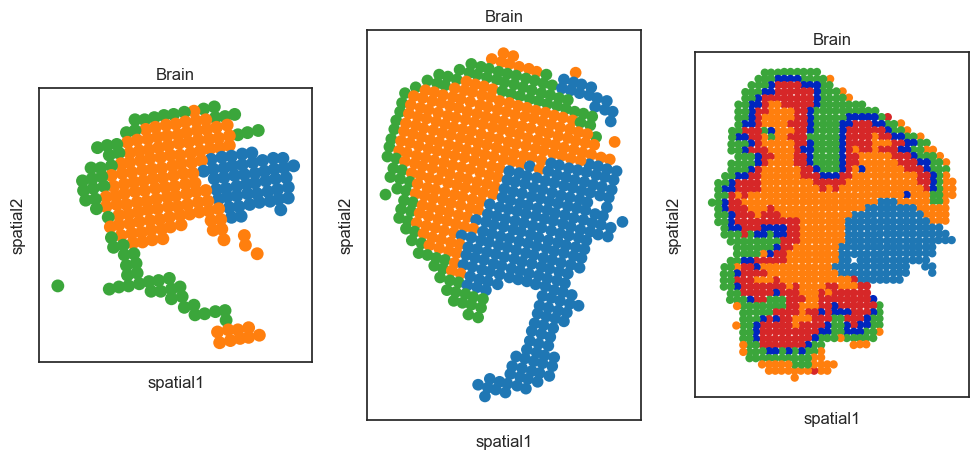

In [29]:

sns.set(style="ticks", font_scale=1)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(12,20))
s=12
c='Brain'
sc.pl.spatial(adata_E17_Cere,img_key=None,spot_size=s, palette=color_dict,legend_loc=None,
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,
        ax=axes[0],show=False)
sc.pl.spatial(adata_P0_Cere, img_key=None,spot_size=s, palette=color_dict,legend_loc=None,
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,
        ax=axes[1],show=False)
sc.pl.spatial(adata_P4_Cere,img_key=None,spot_size=s, palette=color_dict,legend_loc=None,
              color=[c], cmap='Spectral_r',  vmin='p1',vmax='p99',
              basis='spatial' ,
         ax=axes[2],show=False)




In [30]:
adata_E17_Cere.obs['stage']='E17.5'
adata_P0_Cere.obs['stage']='P0'
adata_P4_Cere.obs['stage']='P4'
adata_all = sc.concat([adata_E17_Cere,adata_P0_Cere,adata_P4_Cere],join='outer')

In [31]:
sc.pp.highly_variable_genes(adata_all,n_top_genes=16000) 

# 去批次合并小脑

In [32]:
import scanpy.external as sce
import time
sc.tl.pca(adata_all, svd_solver="arpack", use_highly_variable=True)
sce.pp.harmony_integrate(adata_all, key =['sample'])
sc.pp.neighbors(adata_all,  use_rep='X_pca_harmony', n_neighbors=50)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start umap')
sc.tl.umap(adata_all)
adata_all.obsm['X_pca']=adata_all.obsm['X_pca_harmony']
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start tsne')
sc.tl.tsne(adata_all)
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start leiden')
sc.tl.leiden(adata_all, resolution=1,key_added='leiden_all')
print(time.strftime("%Y-%m-%d %H:%M:%S", time.localtime()),' - Start louvain')
sc.tl.louvain(adata_all, resolution=1,key_added='louvain_all')


2024-05-19 16:37:08,066 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-05-19 16:37:13,209 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-05-19 16:37:13,224 - harmonypy - INFO - Iteration 1 of 10
2024-05-19 16:37:13,512 - harmonypy - INFO - Iteration 2 of 10
2024-05-19 16:37:13,796 - harmonypy - INFO - Converged after 2 iterations


2024-05-19 16:37:46  - Start umap
2024-05-19 16:37:55  - Start tsne
2024-05-19 16:38:01  - Start leiden
2024-05-19 16:38:03  - Start louvain


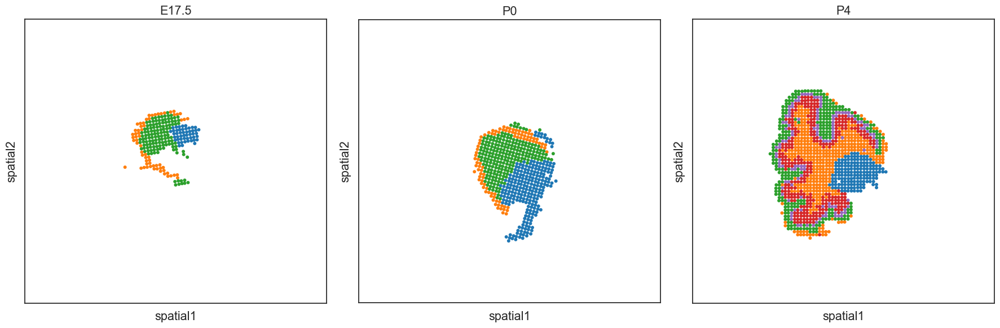

In [101]:
sns.set(style="ticks", font_scale=1.3)
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18,8))
s=10
c='Brain'
sc.pl.spatial(adata_all[adata_all.obs['stage']=='E17.5'], img_key="hires",spot_size=s, 
              color=c, cmap='Spectral_r',palette=color_list,
              legend_loc=None,title='E17.5',crop_coord=[ 1230+200,3130-800,407+200,1757-300],# col row
              ax=axes[0], show=False)
sc.pl.spatial(adata_all[adata_all.obs['stage']=='P0'], img_key="hires",spot_size=s, 
              color=c, cmap='Spectral_r',palette=color_list,
              legend_loc=None,title='P0',crop_coord=[ 1284-200,3284-1200-100,438+300,1785-200],
              ax=axes[1], show=False)
sc.pl.spatial(adata_all[adata_all.obs['stage']=='P4'], img_key="hires",spot_size=s, 
              color=c, cmap='Spectral_r', palette=color_list,
              legend_loc=None,title='P4',crop_coord=[790-200,2790-1200-100,350+200+100,1700-200],
              ax=axes[2], show=False)
plt.subplots_adjust(wspace=.2,hspace=.2)
plt.tight_layout()
#plt.savefig('D:/Task/Zhao_lab/Zhujunjie/file/Fig/Fig1/Fig1-adata_reg_filtered-louvain-post.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [109]:
adata_all.write('adata_Cere.h5ad')

## 伪时间发育分析

In [3]:
color_dict={
     'Cere_EGZ': '#63b963',
     'Cere_PCC': '#ffa85d',
     'CbN': '#1f77b4',
     'CbXWM': '#ff7f0e',
     'CbXegr': '#3ba63b',
     'CbXigr': '#d62728',
     'CbXpu': '#0026bf',
           }

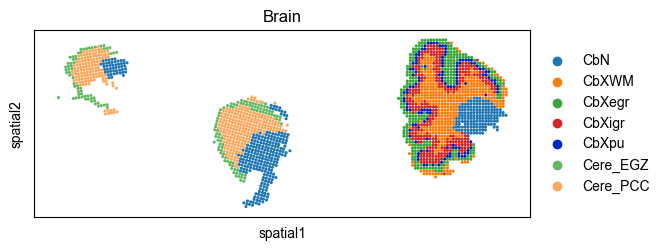

In [4]:
adata_3d=sc.read('../file/Mouse_Embryo_M9_150_20um/st_adata/adata_Cere.h5ad')
adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P0',0]=adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P0',0]+800
adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P4',0]=adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P4',0]+2000
sc.pl.spatial(adata_3d, img_key=None,spot_size=10, 
              color=['Brain'],  palette=color_dict,  
              vmin='p1',vmax='p99',
               #crop_coord= [-10,686,-10,686],
             show=True)

## 小脑时期 marker

In [446]:
#adata_3d.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata_3d, groupby='stage', method='wilcoxon', use_raw =False)
sc.tl.filter_rank_genes_groups(adata_3d)


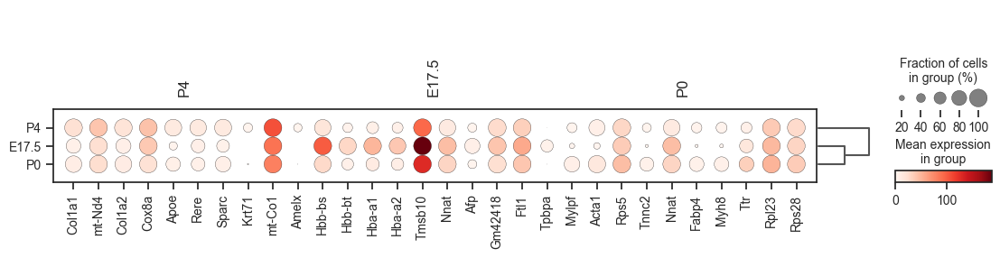

In [447]:
sc.pl.rank_genes_groups_dotplot(adata_3d, n_genes=10)

{'heatmap_ax': <AxesSubplot: >,
 'groupby_ax': <AxesSubplot: xlabel='stage'>,
 'gene_groups_ax': <AxesSubplot: >}

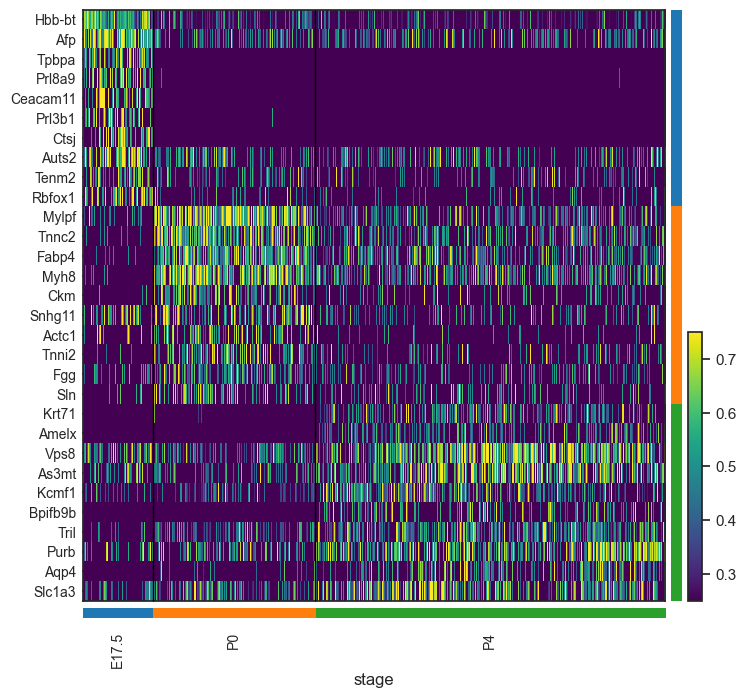

In [448]:
sc.pl.rank_genes_groups_heatmap(adata_3d,n_genes=10,key='rank_genes_groups_filtered',
                                swap_axes=True,cmap='viridis', dendrogram=False,
                                figsize=(8,8),standard_scale='var',show=False,
                                vmin=0.25,vmax=0.75,
                               use_raw=False)
#plt.savefig('../Figure/Figure3/Figure-marker-heatmap-P4.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [449]:
# 每个聚类的前10个高差异表达的基因
rank_genes = pd.DataFrame(adata_3d.uns['rank_genes_groups_filtered']['names'])
print(rank_genes.head(3))
#[i for i in rank_genes['CbN'][0:10] if isinstance(i, (str, bytes))]

    E17.5     P0   P4
0     NaN  Mylpf  NaN
1  Hbb-bt    NaN  NaN
2     NaN    NaN  NaN


In [450]:
rank_genes.columns

Index(['E17.5', 'P0', 'P4'], dtype='object')

In [488]:
marker_genes_dict={}
for c in rank_genes.columns:
    marker_genes_dict[c]=[i for i in rank_genes[c] if isinstance(i, (str, bytes))][0:10]


In [489]:
marker_genes_dict

{'E17.5': ['Hbb-bt',
  'Afp',
  'Tpbpa',
  'Prl8a9',
  'Ceacam11',
  'Prl3b1',
  'Ctsj',
  'Auts2',
  'Tenm2',
  'Rbfox1'],
 'P0': ['Mylpf',
  'Tnnc2',
  'Fabp4',
  'Myh8',
  'Ckm',
  'Snhg11',
  'Actc1',
  'Tnni2',
  'Fgg',
  'Sln'],
 'P4': ['Krt71',
  'Amelx',
  'Vps8',
  'As3mt',
  'Kcmf1',
  'Bpifb9b',
  'Tril',
  'Purb',
  'Aqp4',
  'Slc1a3']}

In [486]:
#marker_genes_dict['P4']=marker_genes_dict['P4']+['Shh']

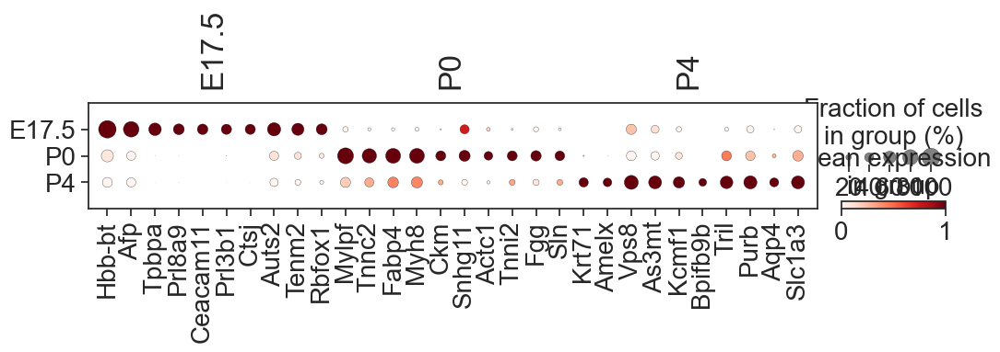

In [490]:
sc.pl.dotplot(adata_3d, marker_genes_dict, 
              groupby="stage",figsize=(12,1.5),show=False,
              standard_scale='var',dendrogram=False)
plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/Cere-stage-marker.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()

## 小脑 marker

In [437]:
#adata_3d.uns['log1p']['base']=None
#adata_3d_P4=adata_3d[adata_3d.obs['stage']=='P4']
sc.tl.rank_genes_groups(adata_3d, groupby='Brain', method='wilcoxon', use_raw =False)
sc.tl.filter_rank_genes_groups(adata_3d)


meta NOT subset; don't know how to subset; dropped


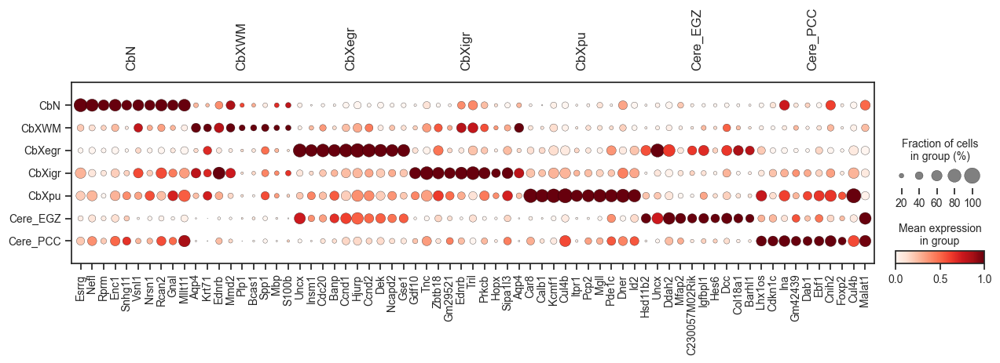

In [438]:
sc.pl.rank_genes_groups_dotplot(adata_3d, n_genes=10, 
                                dendrogram=False,
                                   standard_scale='var',key='rank_genes_groups_filtered',              
                                groupby="Brain",
                                figsize=(15,3),show=False)
plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/Cere-Brain-marker.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')

In [354]:
# 每个聚类的前10个高差异表达的基因
rank_genes = pd.DataFrame(adata_3d_P4.uns['rank_genes_groups_filtered']['names'])
print(rank_genes.head(3))
#[i for i in rank_genes['CbN'][0:10] if isinstance(i, (str, bytes))]

   CbN CbXWM CbXegr CbXigr CbXpu
0  NaN   NaN    NaN    NaN   NaN
1  NaN   NaN    NaN    NaN   NaN
2  NaN   NaN    NaN    Tnc  Car8


In [356]:
rank_genes.columns

Index(['CbN', 'CbXWM', 'CbXegr', 'CbXigr', 'CbXpu'], dtype='object')

In [357]:
marker_genes_dict={}
for c in rank_genes.columns:
    marker_genes_dict[c]=[i for i in rank_genes[c] if isinstance(i, (str, bytes))][0:10]


meta NOT subset; don't know how to subset; dropped


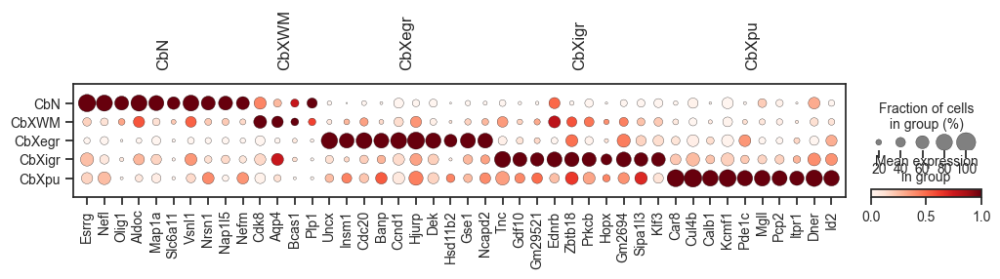

In [391]:
sc.pl.dotplot(adata_3d_P4, marker_genes_dict, 
              groupby="Brain",figsize=(12,1.5),show=False,
              standard_scale='var',dendrogram=False)

# Monocle3 Python

In [5]:
import os
import h5py
import numpy as np
from scipy import sparse
from matplotlib import pyplot as plt
from py_monocle import learn_graph, order_cells
from py_monocle import compute_cell_states
from py_monocle import regression_analysis

## Learn the trajectory graph

In [7]:
projected_points, mst, centroids = learn_graph(
  matrix=adata_3d.obsm['X_umap'], clusters=np.array(adata_3d.obs['Brain']),
)

## Pseudotime

In [507]:
pseudotime = order_cells(
  adata_3d.obsm['X_umap'], centroids,
  mst=mst,
  projected_points=projected_points,
  root_cells=66,
)

## Plot trajectory graph

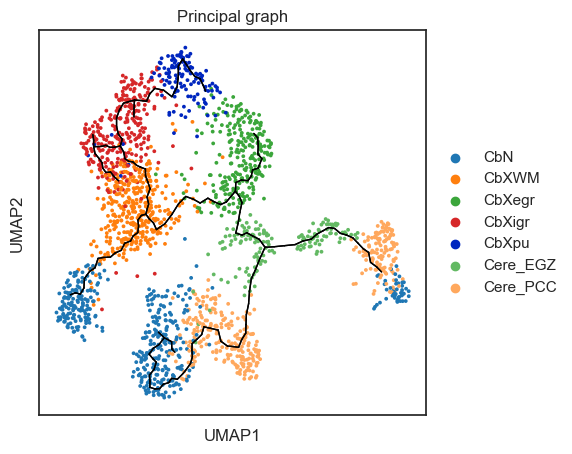

In [508]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=['Brain'], 
           cmap='Spectral_r', 
           palette=color_dict,
           title='Principal graph',
               show=False)

edges = np.array(mst.nonzero()).T
for edge in edges:
  plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)
plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/Cere-Pseudotime-PATH.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()

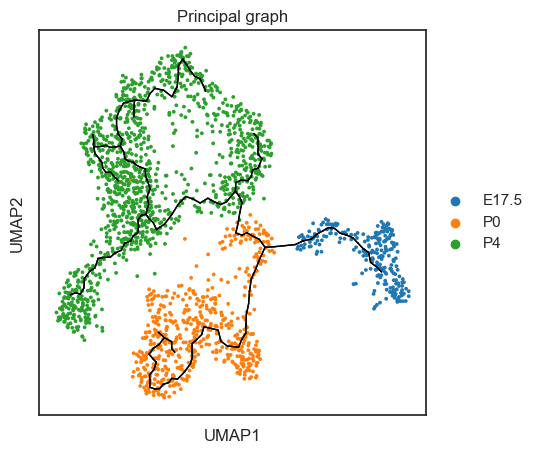

In [509]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=['stage'], 
           cmap='Spectral_r', 
           palette=color_list,
           title='Principal graph',
               show=False)

edges = np.array(mst.nonzero()).T
for edge in edges:
  plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)
plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/Cere-Pseudotime-PATH-stage.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()

In [510]:
cell_states, _ = compute_cell_states(adata_3d.obsm['X_umap'], centroids, mst)
adata_3d.obs['cell_states']=cell_states
adata_3d.obs['pseudotime']=pseudotime

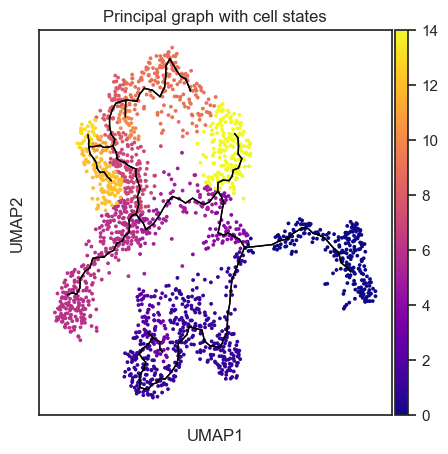

In [511]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=['cell_states'], 
           cmap='plasma', 
           palette=color_list,
           title='Principal graph with cell states',
               show=False)

edges = np.array(mst.nonzero()).T
for edge in edges:
  plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)
plt.show()




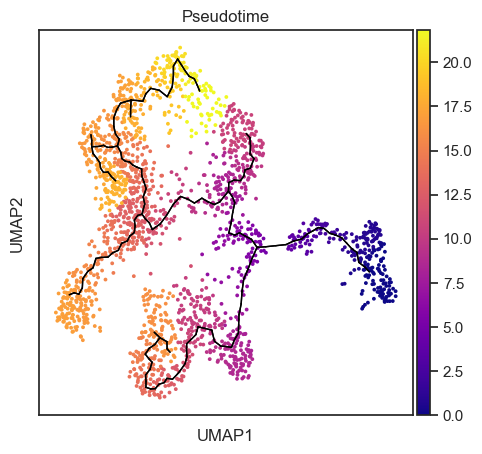

In [512]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5.3,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=['pseudotime'], 
           cmap='plasma', 
           palette=color_dict,
           title='Pseudotime',
               show=False)
edges = np.array(mst.nonzero()).T
for edge in edges:
  plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)
    
plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/Cere-Pseudotime.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()




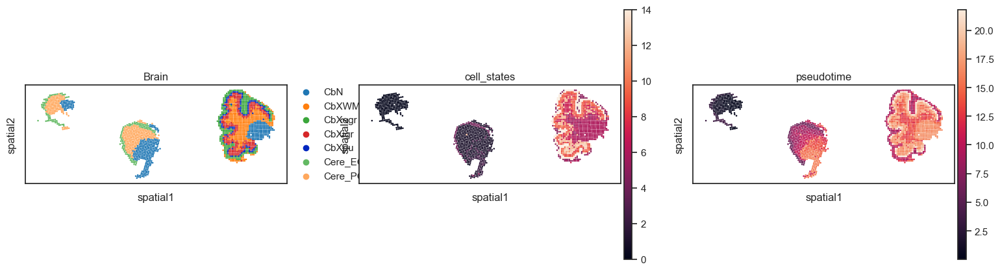

In [513]:
sc.pl.spatial(adata_3d, img_key=None,spot_size=10, 
              color=['Brain','cell_states','pseudotime'],  palette=color_dict,  
              vmin='p1',vmax='p99',
               #crop_coord= [-10,686,-10,686],
             show=True)

# scVelo- Dynamical Model

In [8]:
import scvelo as scv

## step2 数据处理

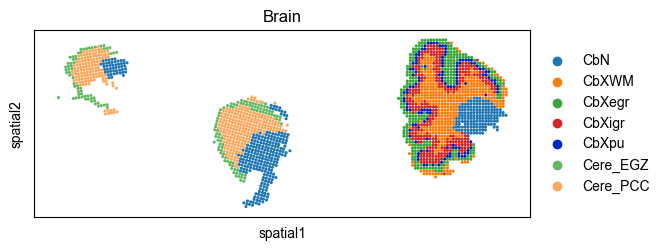

Filtered out 22999 genes that are detected 5 counts (shared).
Normalized count data: X, spliced, unspliced.
Skip filtering by dispersion since number of variables are less than `n_top_genes`.
Logarithmized X.
computing moments based on connectivities


D:\Exe\Anaconda3\envs\py39_spatial\Lib\site-packages\scvelo\preprocessing\utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [9]:
# adata_3d=sc.read('../file/Mouse_Embryo_M9_150_20um/st_adata/adata_Cere.h5ad')
# adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P0',0]=adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P0',0]+800
# adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P4',0]=adata_3d.obsm['spatial'][adata_3d.obs['stage']=='P4',0]+2000
sc.pl.spatial(adata_3d, img_key=None,spot_size=10, 
              color=['Brain'],  palette=color_dict,  
              vmin='p1',vmax='p99',
               #crop_coord= [-10,686,-10,686],
             show=True)

adata_3d.X=adata_3d.layers['raw'].copy()
scv.pp.filter_and_normalize(adata_3d, min_shared_counts=5, n_top_genes=16000)
scv.pp.moments(adata_3d, n_pcs=30, n_neighbors=30)

## step3 速度计算

In [10]:
scv.tl.recover_dynamics(adata_3d)
scv.tl.velocity(adata_3d,vkey='dynamical_velocity', mode='dynamical')
scv.tl.velocity_graph(adata_3d,vkey='dynamical_velocity')


recovering dynamics (using 1/16 cores)


D:\Exe\Anaconda3\envs\py39_spatial\Lib\site-packages\ipywidgets\widgets\widget.py:528: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.
  self.comm = Comm(**args)


  0%|          | 0/174 [00:00<?, ?gene/s]

    finished (0:00:54) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:00:00) --> added 
    'dynamical_velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/16 cores)


D:\Exe\Anaconda3\envs\py39_spatial\Lib\site-packages\ipywidgets\widgets\widget.py:528: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.
  self.comm = Comm(**args)


  0%|          | 0/2034 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'dynamical_velocity_graph', sparse matrix with cosine correlations (adata.uns)


## step4 结果可视化

computing velocity embedding
    finished (0:00:00) --> added
    'dynamical_velocity_umap', embedded velocity vectors (adata.obsm)


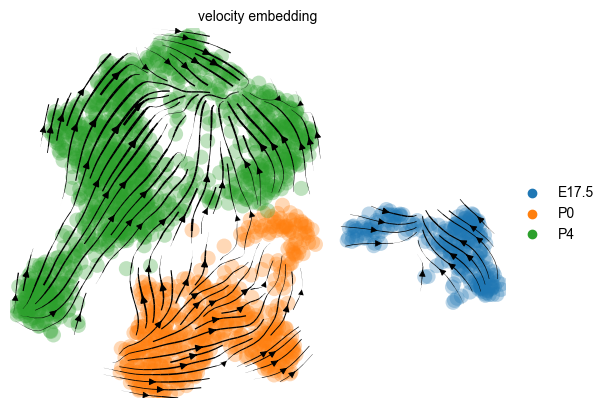

In [11]:
scv.pl.velocity_embedding_stream(adata_3d, basis='umap', vkey='dynamical_velocity',colorbar=True, color='stage',title='velocity_embedding',legend_loc='right margin')

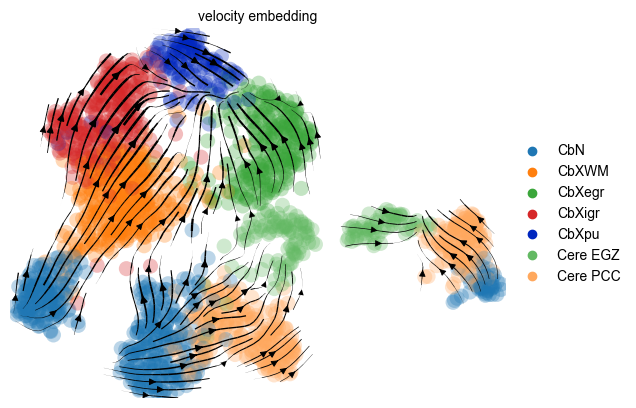

In [12]:
scv.pl.velocity_embedding_stream(adata_3d, basis='umap', vkey='dynamical_velocity',colorbar=True, palette=color_dict,  color='Brain',title='velocity_embedding',legend_loc='right margin')

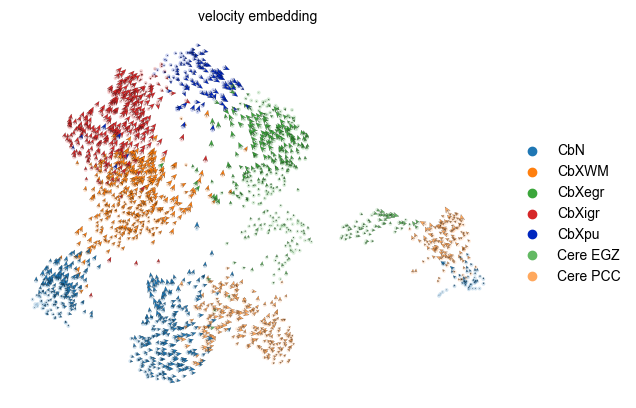

In [13]:
#第二张
scv.pl.velocity_embedding(adata_3d, basis='umap',vkey='dynamical_velocity',title='velocity_embedding',palette=color_dict,  
arrow_length=2,color='Brain',arrow_size=2, legend_loc='right margin')


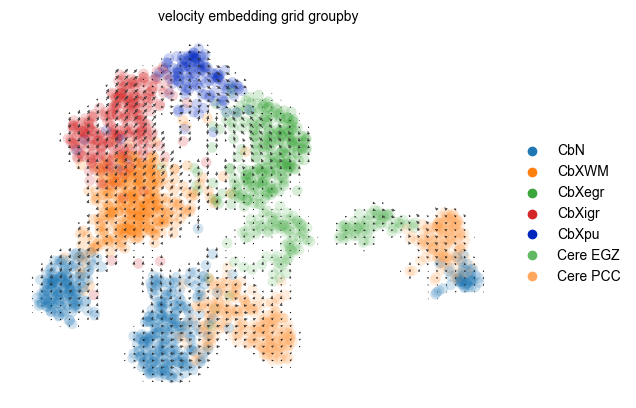

In [14]:
#第三张
scv.pl.velocity_embedding_grid(adata_3d, basis='umap',vkey='dynamical_velocity',color='Brain',title='velocity_embedding_grid_groupby',palette=color_dict,  legend_loc='right margin')

## step5 latent time

computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


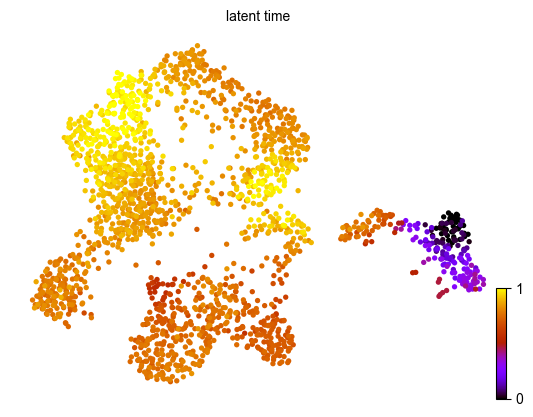

In [15]:
#计算潜伏时间
scv.tl.recover_latent_time(adata_3d, vkey='dynamical_velocity')
scv.pl.scatter(adata_3d,basis='umap',
               color='latent_time',
               color_map='gnuplot',
               colorbar=True,
               perc=[2, 98], #指定连续着色的百分比。
               rescale_color=[0,1])

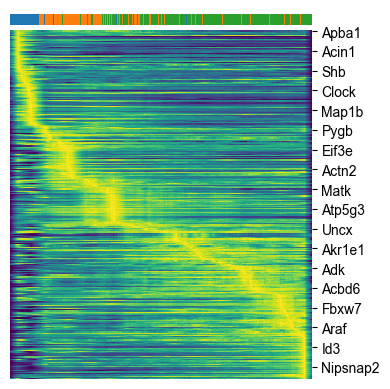

In [16]:
#取出Top300的likelihood genes信息，并保存，绘制热图
TopGenes = adata_3d.var['fit_likelihood'].sort_values(ascending=False).index[:300]
df = pd.DataFrame(TopGenes)
df=df.transpose()
df.to_csv('../Figure/Figure3/Cere_Top300_likelihood_genes_data.csv')
#绘制热图
scv.pl.heatmap(adata_3d, var_names=TopGenes, 
               sortby='latent_time', figsize=(4,4),
               col_color='stage',#选择作为注释条的列名
               n_convolve=100#平滑曲线的核数
               )

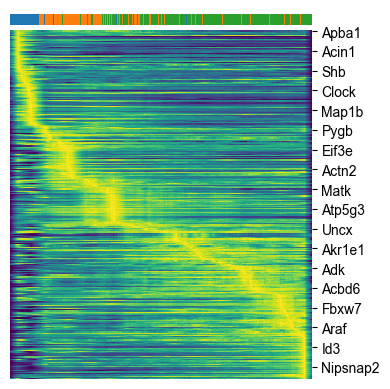

In [20]:
ax= scv.pl.heatmap(adata_3d, var_names=TopGenes, colorbar=True,
               sortby='latent_time', figsize=(4,4),show=False,
               col_color='stage',#选择作为注释条的列名
               n_convolve=100#平滑曲线的核数
               )

meta NOT subset; don't know how to subset; dropped


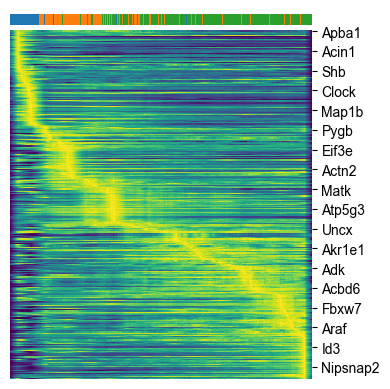

In [23]:
ax= scv.pl.heatmap(adata_3d, var_names=TopGenes, colorbar=True,
               sortby='latent_time', figsize=(4,4),show=False,
               col_color='stage',#选择作为注释条的列名
               n_convolve=100#平滑曲线的核数
               )
plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/a.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()

meta NOT subset; don't know how to subset; dropped


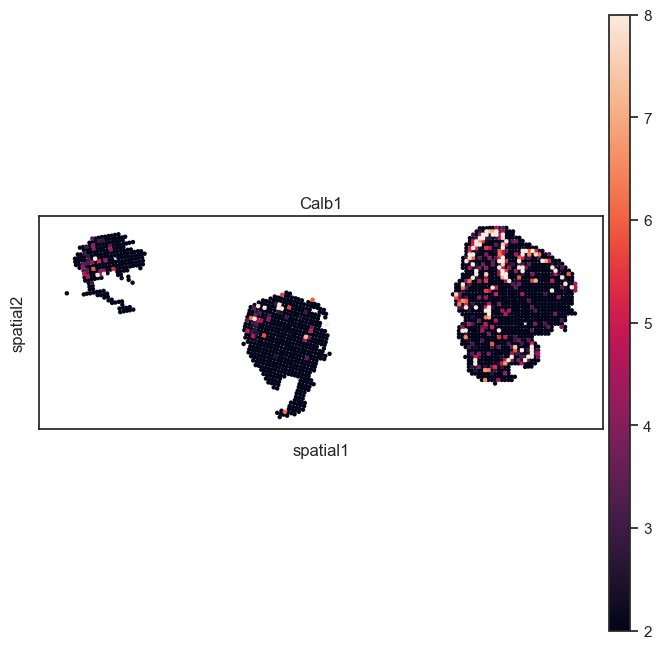

In [426]:
plt.rcParams['figure.figsize']=(8,8)

sc.pl.spatial(adata_3d, img_key=None,spot_size=12.5, 
              color='Calb1',  palette=color_list,  
              vmin=2,vmax=8,
               #crop_coord= [-10,686,-10,686],
             show=False)
plt.show()

meta NOT subset; don't know how to subset; dropped


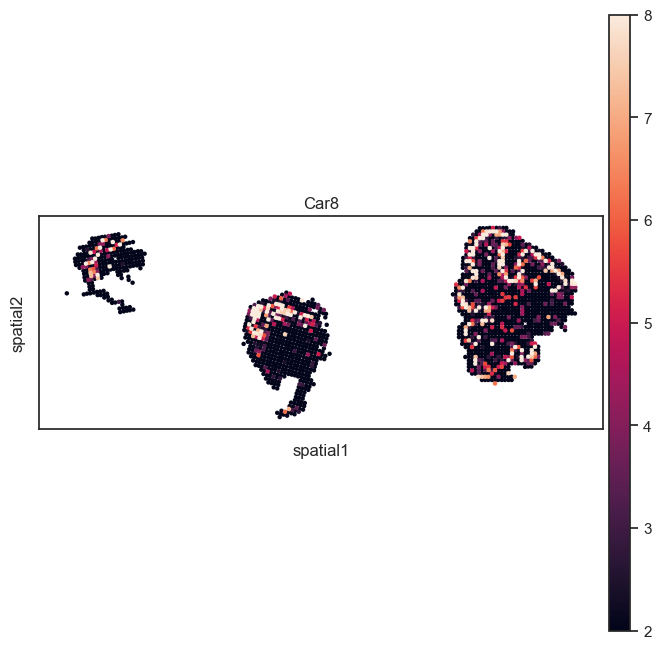

In [429]:
plt.rcParams['figure.figsize']=(8,8)

sc.pl.spatial(adata_3d, img_key=None,spot_size=12.5, 
              color='Car8',  palette=color_list,  
              vmin=2,vmax=8,
               #crop_coord= [-10,686,-10,686],
             show=False)
plt.show()

meta NOT subset; don't know how to subset; dropped


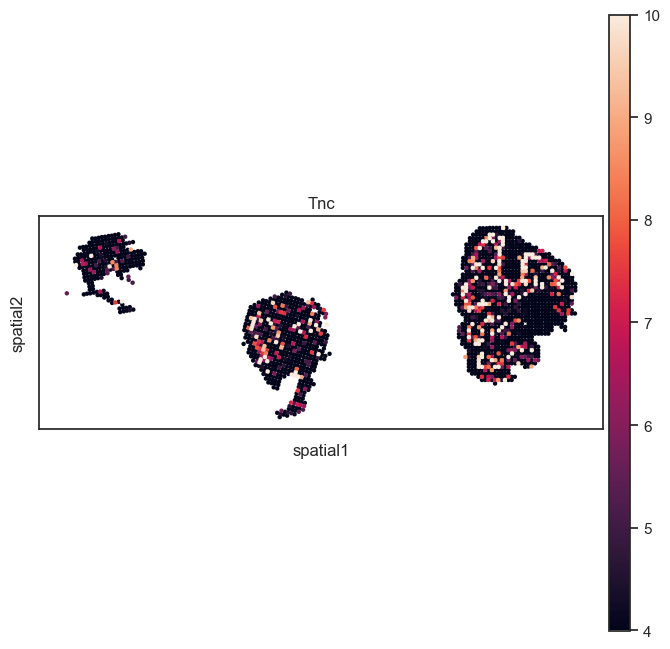

In [427]:
plt.rcParams['figure.figsize']=(8,8)

sc.pl.spatial(adata_3d, img_key=None,spot_size=12.5, 
              color='Tnc',  palette=color_list,  
              vmin=4,vmax=10,
               #crop_coord= [-10,686,-10,686],
             show=False)
plt.show()

meta NOT subset; don't know how to subset; dropped


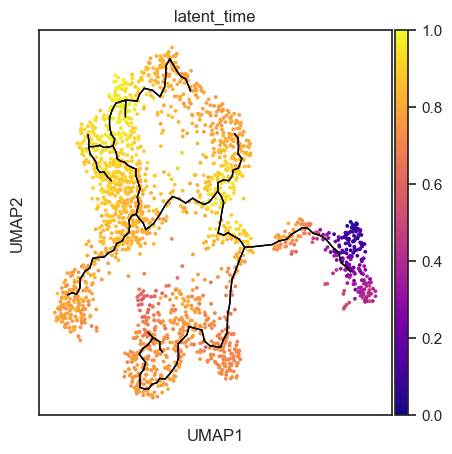

In [260]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=['latent_time'], 
           cmap='plasma', 
           palette=color_list,
          # title='Pseudotime',
               show=False)
edges = np.array(mst.nonzero()).T
for edge in edges:
  plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)

plt.show()

meta NOT subset; don't know how to subset; dropped


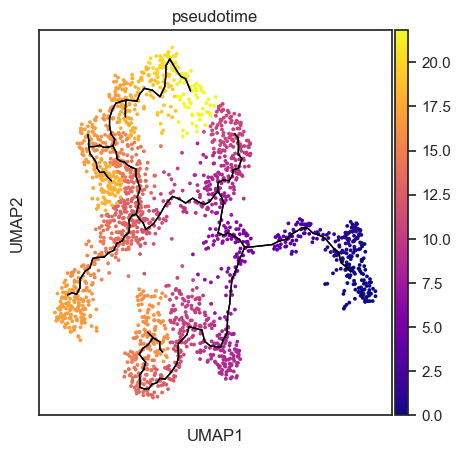

In [262]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=['pseudotime'], 
           cmap='plasma', 
           palette=color_list,
          # title='Pseudotime',
               show=False)
edges = np.array(mst.nonzero()).T
for edge in edges:
  plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)

plt.show()

In [ ]:
import seaborn as sns
plt.rcParams['figure.figsize']=(5,5)
sns.set(style="ticks", font_scale=1)
sc.pl.umap(adata_3d, #legend_loc='on data',
           size=30, #alpha=0.8,
           wspace=.3,
              color=TopGenes[:5], 
           cmap='plasma', 
           palette=color_list,
          # title='Pseudotime',
               show=False)

plt.show()

In [263]:
adata_3d

AnnData object with n_obs × n_vars = 2034 × 1943
    obs: 'sample', 'Spot_col', 'Spot_row', 'in_tissue', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rp', 'log1p_total_counts_rp', 'pct_counts_rp', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Pixel_col', 'Pixel_row', 'sample_2', 'n_genes', 'leiden', 'louvain', 'kmeans', 'leiden_spatial', 'leiden_spatial_1', 'leiden_spatial_2', 'leiden_spatial_3', 'leiden_spatial_4', 'leiden_spatial_5', 'leiden_spatial_6', 'Tissue', 'leiden_spatial_7', 'leiden_all', 'leiden_all_1', 'leiden_all_2', 'leiden_all_3', 'leiden_all_4', 'leiden_all_5', 'leiden_all_6', 'Brain', 'leiden_all_7', 'leiden_all_8', 'leiden_all_9', 'stage', 'leiden_spatial_8', 'louvain_all', 'cell_states', 'pseudotime', 'initial_size_u

In [267]:
import gseapy as gp 
from gseapy import barplot, dotplot
gp.get_library_name()

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_2024',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019',
 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019',
 'Descartes_Cell_Types_and_Tissue_2021',
 'Diabetes_Perturbatio

In [270]:
TopGenes=list(TopGenes)

In [273]:
import gseapy as gp
enr_up_kegg = gp.enrichr(TopGenes,
                    gene_sets='KEGG_2019_Mouse',
                    outdir=None)

enr_up_BP = gp.enrichr(TopGenes,
                    gene_sets='GO_Biological_Process_2023',
                    outdir=None)


enr_up_CC = gp.enrichr(TopGenes,
                    gene_sets='GO_Cellular_Component_2023',
                    outdir=None)


enr_up_MF = gp.enrichr(TopGenes,
                    gene_sets='GO_Molecular_Function_2023',
                    outdir=None)



In [288]:
# concat results
enr_up_kegg.res2d['type'] = "KEGG"

enr_up_BP.res2d['type'] = "BP"


enr_up_CC.res2d['type'] = "CC"


enr_up_MF.res2d['type'] = "MF"


enr_res_KEGG = enr_up_kegg.res2d.head()

enr_res_GO = pd.concat([enr_up_BP.res2d.head(), 

                    enr_up_CC.res2d.head(), 

                    enr_up_MF.res2d.head()])

meta NOT subset; don't know how to subset; dropped
meta NOT subset; don't know how to subset; dropped


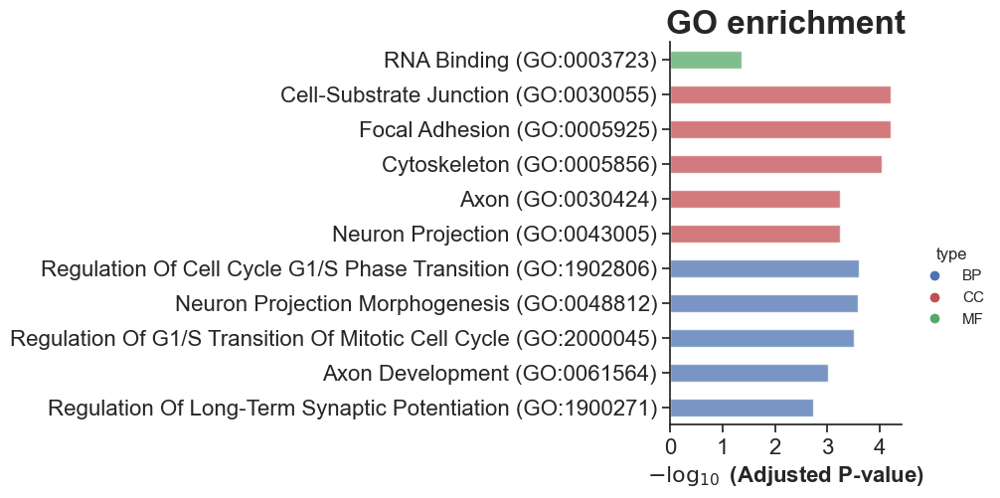

In [295]:
ax = gp.barplot(enr_res_GO, figsize=(3,5),
                group ='type',
                title ="GO enrichment",
                color = ['b','r','g'])
# import seaborn as sns
# plt.rcParams['figure.figsize']=(5,5)
# sns.set(style="ticks", font_scale=1)
# sc.pl.umap(adata_3d, #legend_loc='on data',
#            size=30, #alpha=0.8,
#            wspace=.3,
#               color=['dynamical_velocity_pseudotime'], 
#            cmap='plasma', 
#            palette=color_list,
#           # title='Pseudotime',
#                show=False)
# edges = np.array(mst.nonzero()).T
# for edge in edges:
#   plt.plot(centroids[edge, 0], centroids[edge, 1], c="black", linewidth=1)

plt.savefig('D:/Task/Project/MAGIC_seq/Figure/Figure3/Cere-GO.pdf', dpi = 300, transparent=True, format = 'pdf', bbox_inches='tight')
plt.show()